# Vorhersage der Weinqualität von Vinho Verde


<br>

<div>
<p style="float: left;"><img src="https://www.ovinho.de/media/image/4f/52/5e/MApofVinhoVerde.jpg" alt="drawing" width="300" style="padding: 10px; float: right;"/></p>
<p>Dieses Jupyter Notebook widmet sich der Vorhersage von Weinqualität des <a href="https://de.wikipedia.org/wiki/Vinho_Verde">Vinho Verde</a>.
    <br><br>
    Vinho Verde, oder auch der grüne Wein ist ein junger portugisischer Wein, der aus den Anbaugebieten zwischen den Flüssen Douro und Minho im Norden Portugals stammt.
    <br><br>
    Als Rebsorten dienen unter anderem <a href="https://de.wikipedia.org/wiki/Alvarinho">Alvarinho</a>, <a href="https://de.wikipedia.org/wiki/Avesso">Avesso</a>, 
    <a href="https://de.wikipedia.org/wiki/Loureiro">Loureiro</a> und <a href="https://de.wikipedia.org/wiki/Trajadura">Trajadura</a>. Gelegentlich wird auch die Rebsorte <a href="https://de.wikipedia.org/wiki/Sercial">Sercial</a> verwendet.
    <br><br>
    </p>
    <p><cite>Das Leben ist zu kurz, um schlechten Wein zu trinken.</cite>  <br> - Johann Wolfgang von Goethe.</p>
</div>
    



## Durchlauf für Professoren und Kommilitonen

Um die Trainingsprozesse zu verkürzen kann man einen Schnelldurchlauf aktivieren. 
Dieser wurde aus den Ergebnissen des Hyperparametertrainings erstellt und enthält bereits beschränkte Parameterbereiche, die zu einem ausreichend guten Ergebnis führen. Dies verkürzt die Laufzeit von Stunden auf <3 Minuten. Die kompletten Durchläufe befinden sich in den CSV-Datei in dem "results" Ordner.

Die Evaluation/Ergebnisse richten sich nach diesen CSV-Dateien.

In [1]:
# Professor oder Kommiltonen?
test_for_professor = False

## Imports

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
import time
from scipy import stats

from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection  import RepeatedKFold, KFold
from sklearn import metrics
from sklearn.pipeline import Pipeline
from sklearn.svm import SVR

import matplotlib.patches as mpatches

# Warnings wurden am Ende rausgefiltert, da "FutureWarnings" durch ältere Funktionen - welche für uns sinnvoller erschienen - 
# erschienen und beim flüssigen Lesen stören.
import warnings
warnings.filterwarnings('ignore')

seed = 42

## Hilfsfunktionen

Definierte Hilfsfunktionen (hauptsächlich für Grafiken), um ein flüssigeres Lesen zu ermöglichen.

In [3]:
def plot_correct_prediction_pairplot(y, y_pred, df):
    """Pairplot, um die Lokalität der falschen Vorhersagen darzustellen
    
    Args:
        y (np.array): Labels des Datensatzes
        y_pred (np.array): Vorhersagen des Modells
        df (pandas.DataFrame): DatenFrame des Datensatzes
    """
    plot_df = df.copy(deep=True)
    plot_df["correct_prediction"] = np.equal(y, np.round(y_pred))
    
    plt.rc('axes', labelsize=14) 
    plt.rc('xtick', labelsize=16) 
    plt.rc('ytick', labelsize=16) 
    p = sns.pairplot(plot_df.drop("quality", axis=1), hue="correct_prediction",palette = sns.color_palette("tab10", n_colors=2), plot_kws={'alpha': 0.5})

def plot_metrics_ensemble(y_test, y_pred, predictions, modelname="MODELNAME"):
    """Plot der Metriken Accuracy, Mean Absolut Error, Mean Squared Error 
    
    Args:
        y_test (np.array): Labels des Testdatensatzes
        y_pred (np.array): Vorhersagen des Modells
        modelname (str): Modellname für die Plots, Defaults ist "MODELNAME"
    """
    metric_list = np.asarray([[metrics.accuracy_score(np.round(predictions[0]),y_test), metrics.accuracy_score(np.round(predictions[1]),y_test), metrics.accuracy_score(np.round(y_pred),y_test)],
                    [metrics.mean_absolute_error(predictions[0],y_test), metrics.mean_absolute_error(predictions[1],y_test), metrics.mean_absolute_error(y_pred,y_test)],
                    [metrics.mean_squared_error(predictions[0],y_test), metrics.mean_squared_error(predictions[1],y_test), metrics.mean_squared_error(y_pred,y_test),]
                    ])
    
    plt.figure(figsize=(8,6))

    ax = plt.subplot(1, 1, 1)
    p = sns.heatmap(metric_list, annot=True, linewidths=.5, cbar = False, annot_kws={"fontsize":18})
    p.set_yticklabels(["Accuracy", "Mean Absolute Error", "Mean Squared Error"], size = 16, rotation=0)

    p.set_xticklabels(["SVR", "RFR", "Ensemble"], size = 16)
    ax.set_title("Ergebnisse "+modelname+" (Testdatensatz)",fontsize=20)

    plt.tight_layout()
    plt.show()
    
def plotEverything_2(df):
    """Plot aller Features des DataFrames
    
    Args:
        df (pandas.DataFrame): DatenFrame
    """
    plt.figure(figsize = (12, 20))
    plotnumber = 1

    for col in df:
        if plotnumber <= 12:
            ax = plt.subplot(6, 2, plotnumber)
            p = sns.distplot(df[col])
            plt.xlabel(col, fontsize = 14)
            plt.ylabel('')

        plotnumber += 1

    plt.tight_layout()
    plt.show()

def plot_correlatedfeatures():
    """Plot der Features mit den höchsten Korrelationen zueinander
    """
    fig, axes = plt.subplots(1,3,figsize=(25,8))

    p = sns.regplot(ax=axes[0], x="density", y="alcohol", data=df, line_kws={'color': 'grey'})
    p.tick_params(labelsize=16)
    p.set_xlabel(p.get_xlabel(),fontsize=22)
    p.set_ylabel(p.get_ylabel(),fontsize=22)
    p = sns.regplot(ax=axes[1],x="density", y="residual sugar",data=df, line_kws={'color': 'grey'})
    p.tick_params(labelsize=16)
    p.set_xlabel(p.get_xlabel(),fontsize=22)
    p.set_ylabel(p.get_ylabel(),fontsize=22)
    p = sns.regplot(ax=axes[2],x="chlorides", y="alcohol",data=df, line_kws={'color': 'grey'})
    p.tick_params(labelsize=16)
    p.set_xlabel(p.get_xlabel(),fontsize=22)
    p.set_ylabel(p.get_ylabel(),fontsize=22)
    
    plt.show()

def plot_correlationmatrix(train_df, threshold = 0):
    """Plot der Korrelationsmatrix des Datensatzes mit gegebener Schwelle
    
    Args:
        train_df (pandas.DataFrame): Datensatz
        threshold (float): Schwelle, ab welchem Korrelationswert der Wert mit geplotet werden soll, Defaults ist 0.
    """
    correlation_matrix = train_df.corr()
    r = []
    for w in np.round(correlation_matrix.values.reshape(-1),2):
        if w > threshold or w < -threshold:
            r.append(str(w))
        else:
            r.append("")
    r = np.array(r).reshape(len(train_df.columns),len(train_df.columns))
    f, ax = plt.subplots(figsize=(9, 6))
    sns.heatmap(correlation_matrix, annot=r, linewidths=.1,ax=ax,fmt="s",cmap=sns.diverging_palette(150, 275, s=80, l=55, n=9), vmin=-1, vmax=1)

def plot_metrics(y_test, y_pred, best_config, modelname="MODELNAME"):
    """Plot der Metriken Accuracy, Mean Absolut Error, Mean Squared Error 
    
    Args:
        y_test (np.array): Labels des Testdatensatzes
        y_pred (np.array): Vorhersagen des Modells
        modelname (str): Modellname für die Plots, Defaults ist "MODELNAME"
    """
    metric_list = np.asarray([[best_config["acc_train"], best_config["acc_val"], metrics.accuracy_score(np.round(y_pred),y_test)],
                    [best_config["mse_train"], best_config["mse_val"], metrics.mean_squared_error(y_pred,y_test),]
                    ])
    
    plt.figure(figsize=(8,6))

    ax = plt.subplot(1, 1, 1)
    p = sns.heatmap(metric_list, annot=True, linewidths=.5, cbar = False, annot_kws={"fontsize":18})
    p.set_yticklabels(["Accuracy", "Mean Squared Error"], size = 16, rotation=0)

    p.set_xticklabels(["Train", "Validation", "Test"], size = 16)
    ax.set_title("Ergebnisse "+modelname,fontsize=20)

    plt.tight_layout()
    plt.show()
    
def plot_rfrfeatureimportance(rfr_model, train_df):
    """Plot der wichtigsten Features des Random Forest Regressor Modells
    
    Args:
        rfr_model (sklearn.ensemble.RandomForestRegressor): Random Forest Regressor Modell
        train_df (pandas.DataFrame): Datenframe (benötigt für die Columns)
    """
    index = np.argsort(rfr_model.feature_importances_)
    performance = rfr_model.feature_importances_[index]
    objects = train_df.drop('quality',axis=1).columns[index]
    y_pos = np.arange(len(objects))

    plt.figure(figsize=(12,8))
    plt.barh(y_pos, performance, align='center', alpha=0.5)
    plt.yticks(y_pos, objects, fontsize=14)
    plt.xticks(fontsize=14)
    plt.xlabel('feature_importances', fontsize=16)
    plt.title('Feature importance Random Forest Regressor', fontsize=20)

    plt.show()
    
def plot_rfr2d_2():
    """2D Plots des Random Forest Regressors
    """
    df = pd.read_csv('results/train_conf_tree.csv')  


    df_min = df[df["min_samples_split"] == 2]
    df_min = df_min[df_min["max_features"] =="log2"]
    df_min=df_min.sort_values(by=['max_depth'])
    fig = plt.figure(figsize = (8,5))
    
    ax = fig.add_subplot(111)
    ax.set_title('Veränderung des MSE im Vergleich zur \n max Tief beim Random Forest', fontsize=20)
    ax.plot(df_min["max_depth"], df_min["mse_val"], '-', label='Validation')
    ax.plot(df_min["max_depth"], df_min["mse_train"], '-', label='Train')
    ax2 = ax.twinx()
    ax2.plot(df_min["max_depth"], df_min["time"], '-',label='time(s) for CV', color='black')
    ax2.legend(loc=3)
    ax.grid()
    ax.set_xlabel("max_depth")
    ax.set_ylabel("MSE")
    ax2.set_ylabel("Time (s)")

    df_min=df_min.sort_values(by=['mse_val'])
    ax.plot(df_min["max_depth"][:1], df_min["mse_val"][:1],  '', color = 'red', marker = 'o', label='min mse')

    df_min=df_min.sort_values(by=['mse_train'])
    ax.plot(df_min["max_depth"][:1], df_min["mse_train"][:1],  '',color = 'red', marker = 'o')
    
    ax.legend(bbox_to_anchor=(1.1, 1), loc='upper left')

    plt.show()

    df_ = df[df["max_features"] =="log2"]
    df_=df_.sort_values(by=['min_samples_split'])
    df_min = df_[df_["max_depth"] == 23]

    fig = plt.figure(figsize = (8,5))
    ax = fig.add_subplot(111)
    ax.plot(df_min["min_samples_split"], df_min["mse_val"], '-', label='Validation')
    ax.plot(df_min["min_samples_split"], df_min["mse_train"], '-', label='Train')
    ax.set_title('Veränderung des MSE im Vergleich zur \n min_samples_split  beim Random Forest', fontsize=20)

    ax2 = ax.twinx()
    ax2.plot(df_min["min_samples_split"], df_min["time"], '-', label="time(s) for CV", color='black')
    ax2.legend(loc=3)
    ax.grid()
    ax.set_xlabel("min_samples_split")
    ax.set_ylabel("MSE")
    ax.invert_xaxis()
    ax2.set_ylabel("Time (s)")

    df_min=df_min.sort_values(by=['mse_val'])
    ax.plot(df_min["min_samples_split"][:1], df_min["mse_val"][:1],  '' ,marker = 'o', color = 'red', label='min mse')

    df_min=df_min.sort_values(by=['mse_train'])
    ax.plot(df_min["min_samples_split"][:1], df_min["mse_train"][:1],  '' ,marker = 'o',color = 'red')

    ax.legend(bbox_to_anchor=(1.1, 1), loc='upper left')
    plt.show()
    
def plot_histograms(y_test, y_pred, modelname="MODELNAME"):
    """Histogrammplots der wahren Values, der gerundeten Vorhersagen und der wahren Vorhersagen
    
    Args:
        y_test (np.array): Labels des Testdatensatzes
        y_pred (np.array): Vorhersagen des Modells
        modelname (str): Modellname für die Plots, Defaults ist "MODELNAME"
    """
    plt.figure(figsize = (16, 5))

    ax = plt.subplot(1, 3, 1)
    p = sns.distplot(y_test)
    p.tick_params(labelsize=12)
    ax.set_ylabel("Number of Datapoints",fontsize=18)
    ax.set_title("Ground Truth",fontsize=20)

    ax = plt.subplot(1, 3, 2)
    p = sns.distplot(np.round(y_pred))
    p.tick_params(labelsize=12)
    ax.set_xlabel("Quality",fontsize=18)
    ax.set_ylabel("Number of Datapoints",fontsize=0)
    ax.set_title("Rounded Prediction "+modelname,fontsize=20)

    ax = plt.subplot(1, 3, 3)
    p = sns.distplot(y_pred)
    p.tick_params(labelsize=12)
    ax.set_ylabel("Number of Datapoints",fontsize=0)
    ax.set_title("Prediction "+modelname,fontsize=20)

    plt.tight_layout()
    plt.show()
    
def plot_confusion_matrix(y_test, y_pred, modelname="MODELNAME", datensatz="DATENSATZ"):
    """Plot der Confusion Matrix mit Recall und Precision
    
    Args:
        y_test (np.array): Labels des Testdatensatzes
        y_pred (np.array): Vorhersagen des Modells
        modelname (str): Modellname für die Plots, Defaults ist "MODELNAME"
        datensatz (str): Datensatz für die Plots, Defaults ist "DATENSATZ"
    """
    mat = metrics.confusion_matrix(y_test, np.round(y_pred))
    cr = metrics.classification_report(y_test, np.round(y_pred),output_dict=True)

    cr_list = []
    for i in np.arange(3,10,1):
        tmp_list = []
        tmp_list.append(cr[str(i)]["precision"])    
        tmp_list.append(cr[str(i)]["recall"])
        cr_list.append(tmp_list)

    cr_list = np.asarray(cr_list)

    plt.figure(figsize = (16, 7))

    ax = plt.subplot(1, 2, 1)
    p = sns.heatmap(mat, annot=True,fmt="d", linewidths=.5, cbar = False, annot_kws={"fontsize":14})
    p.set_yticklabels(np.sort(np.unique(y_test)), size = 16)
    p.set_xticklabels(np.sort(np.unique(y_test)), size = 16)
    ax.set_xlabel("Rounded Prediction of Quality",fontsize=18)
    ax.set_ylabel("Ground Truth Quality",fontsize=18)
    ax.set_title("Confusion Matrix "+modelname+" "+datensatz,fontsize=20)

    palette = sns.color_palette("coolwarm", as_cmap=False)
    palette.reverse()
    ax = plt.subplot(1, 2, 2)
    p = sns.heatmap(cr_list, annot=True, cbar = False, linewidths=.5, annot_kws={"fontsize":14})
    p.set_xticklabels(["Precision", "Recall"], size = 16)
    p.set_yticklabels(np.sort(np.unique(y_test)), size = 0)
    ax.set_title("Precision/Recall "+modelname+" "+datensatz,fontsize=20)

    plt.tight_layout()
    plt.show()

In [4]:
def plotEverything(df):
    """Plot aller Features des DataFrames
    
    Args:
        df (pandas.DataFrame): DatenFrame
    """
    plt.figure(figsize = (25, 20))
    plotnumber = 1

    for col in df:
        if plotnumber <= 12:
            ax = plt.subplot(4, 3, plotnumber)
            sns.distplot(df[col])
            plt.xlabel(col, fontsize = 15)
            plt.ylabel('')

        plotnumber += 1

    plt.tight_layout()
    plt.show()

In [5]:
class CrossValidationValueRecorder:
    """Klasse um die Metriken der Crossvalidation zwischenzuspeichern
    """
    
    def __init__(self):
        """Initialisierung der Klasse
        """
        self.mse_val=[]
        self.acc_val=[]
        self.r2score_val=[]

        self.mse_train=[]
        self.acc_train=[]
        self.r2score_train=[]
        
    def Reset(self):
        """Reset der Klasse
        """
        self.mse_val=[]
        self.acc_val=[]
        self.r2score_val=[]

        self.mse_train=[]
        self.acc_train=[]
        self.r2score_train=[]
    
    def UpdateConfig(self, train_config):
        """Updaten der Trainingsconfig
        
        Args:
            train_config (dict): Trainingsconfiguration
        """
        train_config["mse_val"].append(np.mean(self.mse_val))
        train_config["mse_train"].append(np.mean(self.mse_train))

        train_config["acc_val"].append(np.mean(self.acc_val))
        train_config["acc_train"].append(np.mean(self.acc_train))

        train_config["r2score_val"].append(np.mean(self.r2score_val))
        train_config["r2score_train"].append(np.mean(self.r2score_train))
            
    def AddValidationMetric(self, y_val, y_pred):
        """Hinzufügen der Validationsmetriken
        
        Args:
            y_val (np.array): Labels des Validierungsdatensatzes
            y_pred (np.array): Vorhersagen des Modells
        """
        self.mse_val.append(metrics.mean_squared_error(y_val, y_pred))
        self.acc_val.append(metrics.accuracy_score(np.rint(y_val).astype(int),np.rint(y_pred).astype(int)))
        self.r2score_val.append(metrics.r2_score(y_val,y_pred))
    
    def AddTrainMetric(self, y_train, y_pred):
        """Hinzufügen der Trainingsmetriken
        
        Args:
            y_train (np.array): Labels des Trainingsdatensatzes
            y_pred (np.array): Vorhersagen des Modells
        """
        self.mse_train.append(metrics.mean_squared_error(y_train, y_pred))
        self.acc_train.append(metrics.accuracy_score(np.rint(y_train).astype(int),np.rint(y_pred).astype(int)))
        self.r2score_train.append(metrics.r2_score(y_train,y_pred))
    
    def GetMSE(self):
        """Hinzufügen der Trainingsmetriken
        
        Returns:
            np.mean(self.mse_val) (np.array): Durchschnitt des Mean Squared Errors auf den Validierungsdatensatz
        """
        return np.mean(self.mse_val)
    
    
def ProductLength(hyperparameters):
    """Berechnung der Durchläufe eines Trainings
    
    Args:
        hyperparameters (list): Liste aller veränderlichen Hyperparameter

    Returns:
        length (int): Berechnete Anzahl Durchläufe eines Trainings
    """
    length = 1
    for p in hyperparameters:
        sl = max(len(p),1)
        length = length * sl
    return length

In [6]:
def plot_logchanges(df):
    """Plot um die Veränderungen der Features durch das Logarithmieren aufzuzeigen
    
    Args:
        df (pandas.DataFrame): Datensatz
    """
    plt.figure(figsize = (16, 10))
    plotnumber = 1

    for col in ["alcohol", "alcohol_Logarithm", "residual sugar", "residual sugar_Logarithm"]:
        ax = plt.subplot(2, 2, plotnumber)
        sns.distplot(df[col])
        plt.xlabel(col, fontsize = 15)
        plt.ylabel('')
        plotnumber += 1

    plt.show()

def plot_rfr3d():
    """3D Plots des Random Forest Regressors 
    """
    df = pd.read_csv("results/train_conf_tree.csv")
    df_sqrt = df.loc[df['max_features'] == "sqrt"]
    df_log2 = df.loc[df['max_features'] == "auto"]

    fig = plt.figure(figsize=(16,10))

    ##first plot
    ax = fig.add_subplot(1, 2, 1, projection='3d')
    ax.set_title("MSE: sqrt")
    ax.set_xlabel('max_depth')
    ax.set_ylabel('min_samples_split')
    ax.set_zlabel('mse')

    plot_val = ax.plot_trisurf(df_sqrt["max_depth"].values, df_sqrt["min_samples_split"].values, df_sqrt["mse_val"],cmap='viridis',label='Validation')
    plot_val._facecolors2d = plot_val._facecolor3d
    plot_val._edgecolors2d = plot_val._edgecolor3d

    plot_train = ax.plot_trisurf(df_sqrt["max_depth"].values, df_sqrt["min_samples_split"].values, df_sqrt["mse_train"],cmap='inferno',label="Train")
    plot_train._facecolors2d = plot_train._facecolor3d
    plot_train._edgecolors2d = plot_train._edgecolor3d

    fig.colorbar(plot_train,location="bottom",shrink=0.7)

    blue_patch = mpatches.Patch(color='tab:blue', label='Validation')
    red_patch = mpatches.Patch(color='firebrick', label='Train')
    ax.legend(handles=[blue_patch,red_patch])

    # second plot
    ax = fig.add_subplot(1, 2, 2, projection='3d')
    ax.set_title("MSE: sqrt")
    ax.set_xlabel('max_depth')
    ax.set_ylabel('min_samples_split')
    ax.set_zlabel('mse_vals')

    plot = ax.plot_trisurf(df_sqrt["max_depth"].values, df_sqrt["min_samples_split"].values, df_sqrt["mse_val"],cmap='viridis', label="Validation")
    plot._facecolors2d = plot._facecolor3d
    plot._edgecolors2d = plot._edgecolor3d
    plt.legend()

    fig.colorbar(plot,location="bottom",shrink=0.7)

    min_x = df_sqrt["max_depth"].iloc[np.argmin(df_sqrt["mse_val"])]
    min_y = df_sqrt["min_samples_split"].iloc[np.argmin(df_sqrt["mse_val"])]
    min_z = df_sqrt["mse_val"].iloc[np.argmin(df_sqrt["mse_val"])]

    ax.plot(min_x,min_y,min_z,marker="o",c=plt.cm.coolwarm(1.))

def plot_svr_3d():
    """3D Plots des Support Vector Regressors
    """
    df = pd.read_csv("results/train_conf_svr.csv")

    df_std = df.loc[df['scaler'] == "StandardScaler()"]
    df_minmax = df.loc[df['scaler'] == "MinMaxScaler()"]

    df_std = df_std.loc[df_std['gamma'] == "0.31622776601683794"]
    df_minmax = df_minmax.loc[df_minmax['gamma'] == "0.31622776601683794"]

    fig = plt.figure(figsize=(16,10))
    # first plot
    
    ax = fig.add_subplot(1, 2, 1, projection='3d')
    ax.set_title("MSE: StandardScaler")
    ax.set_xlabel('C')
    ax.set_ylabel('epsilon')
    ax.set_zlabel('mse')

    plot_val = ax.plot_trisurf(df_std["C"].values, df_std["epsilon"].values, df_std["mse_val"],cmap='viridis',label='Validation')
    plot_val._facecolors2d = plot_val._facecolor3d
    plot_val._edgecolors2d = plot_val._edgecolor3d

    plot_train = ax.plot_trisurf(df_std["C"].values, df_std["epsilon"].values, df_std["mse_train"],cmap='inferno',label="Train")
    plot_train._facecolors2d = plot_train._facecolor3d
    plot_train._edgecolors2d = plot_train._edgecolor3d
    
    fig.colorbar(plot_train,location="bottom",shrink=0.7)

    blue_patch = mpatches.Patch(color='tab:blue', label='Validation')
    red_patch = mpatches.Patch(color='firebrick', label='Train')
    ax.legend(handles=[blue_patch,red_patch])
    
    
    # second plot
   
    ax = fig.add_subplot(1, 2, 2, projection='3d')
    ax.set_title("MSE: StandardScaler")
    ax.set_xlabel('C')
    ax.set_ylabel('epsilon')
    ax.set_zlabel('mse_vals')

    plot = ax.plot_trisurf(df_std["C"].values, df_std["epsilon"].values, df_std["mse_val"].values,cmap='viridis', label="Validation")
    plot._facecolors2d = plot._facecolor3d
    plot._edgecolors2d = plot._edgecolor3d
    plt.legend()

    fig.colorbar(plot,location="bottom",shrink=0.7)

    min_x = df_std["C"].iloc[np.argmin(df_std["mse_val"])]
    min_y = df_std["epsilon"].iloc[np.argmin(df_std["mse_val"])]
    min_z = df_std["mse_val"].iloc[np.argmin(df_std["mse_val"])]
    ax.plot(min_x,min_y,min_z,marker="o",c=plt.cm.coolwarm(1.))
    
def plot_svr_feat_sel3d():
    """3D Plots des Support Vector Regressors mit Feature Selection
    """
    df = pd.read_csv("results/train_conf_svr_feat_sel.csv")

    df_minmax = df.loc[df['scaler'] == "MinMaxScaler()"]
    df_minmax = df_minmax.loc[df_minmax['gamma'] == "scale"]

    fig = plt.figure(figsize = (16,10))

    ax = fig.add_subplot(1, 2, 1, projection='3d')
    ax.set_title("MSE: MinMaxScaler")
    ax.set_xlabel('C')
    ax.set_ylabel('epsilon')
    ax.set_zlabel('mse')

    plot_val = ax.plot_trisurf(df_minmax["C"].values, df_minmax["epsilon"].values, df_minmax["mse_val"],cmap='viridis',label='Validation')
    plot_val._facecolors2d = plot_val._facecolor3d
    plot_val._edgecolors2d = plot_val._edgecolor3d

    plot_train = ax.plot_trisurf(df_minmax["C"].values, df_minmax["epsilon"].values, df_minmax["mse_train"],cmap='inferno',label="Train")
    plot_train._facecolors2d = plot_train._facecolor3d
    plot_train._edgecolors2d = plot_train._edgecolor3d

    fig.colorbar(plot_train,location="bottom",shrink=0.7)

    blue_patch = mpatches.Patch(color='tab:blue', label='Validation')
    red_patch = mpatches.Patch(color='firebrick', label='Train')
    ax.legend(handles=[blue_patch,red_patch])


    ax = fig.add_subplot(1, 2, 2, projection='3d')
    ax.set_title("MSE: MinMaxScaler")
    ax.set_xlabel('C')
    ax.set_ylabel('epsilon')
    ax.set_zlabel('mse_vals')

    plot = ax.plot_trisurf(df_minmax["C"].values, df_minmax["epsilon"].values, df_minmax["mse_val"].values,cmap='viridis', label="Validation")
    plot._facecolors2d = plot._facecolor3d
    plot._edgecolors2d = plot._edgecolor3d
    plt.legend()

    fig.colorbar(plot,location="bottom",shrink=0.7)

    min_x = df_minmax["C"].iloc[np.argmin(df_minmax["mse_val"])]
    min_y = df_minmax["epsilon"].iloc[np.argmin(df_minmax["mse_val"])]
    min_z = df_minmax["mse_val"].iloc[np.argmin(df_minmax["mse_val"])]

    ax.plot(min_x,min_y,min_z,marker="o",c=plt.cm.coolwarm(1.))
    
    
def plot_rfr2d():
    """2D Plots des Random Forest Regressors
    """
    df = pd.read_csv('results/train_conf_tree.csv')  


    df_min = df[df["min_samples_split"] == 2]
    df_min = df_min[df_min["max_features"] =="log2"]
    df_min=df_min.sort_values(by=['max_depth'])
    fig = plt.figure(figsize = (8,5))
    
    ax = fig.add_subplot(111)
    ax.set_title('Veränderung des MSE im Vergleich zur \n max Tief beim Random Forest', fontsize=20)
    ax.plot(df_min["max_depth"], df_min["mse_val"], '-', label='Validation')
    ax.plot(df_min["max_depth"], df_min["mse_train"], '-', label='Train')
    ax2 = ax.twinx()
    ax2.plot(df_min["max_depth"], df_min["time"], '-',label='time(s) for CV', color='black')
    ax2.legend(loc=3)
    ax.grid()
    ax.set_xlabel("max_depth")
    ax.set_ylabel("MSE")
    ax2.set_ylabel("Time (s)")

    df_min=df_min.sort_values(by=['mse_val'])
    ax.plot(df_min["max_depth"][:1], df_min["mse_val"][:1],  '', color = 'red', marker = 'o', label='min mse')

    df_min=df_min.sort_values(by=['mse_train'])
    ax.plot(df_min["max_depth"][:1], df_min["mse_train"][:1],  '',color = 'red', marker = 'o')
    
    ax.legend(bbox_to_anchor=(1.1, 1), loc='upper left')
    
    ax.text(1.5, 0.5, 'Bei dem Plot wird die  min_samples_split  auf zwei gesetzt und den max_features auf log2,\nda so die besten Ergebnis erreicht werden. Der Plot zeigt die Veränderung des MSE in Abhängigkeit \nder  maximale tief der Bäume. Es wird erkennbar, dass kaum eine Verbesserung festgestellt werden \nkann,  bei einer tiefe > 20.  Anhand der Zeit wird erkennbar das die Model bei einer maximale \nTief nicht mehr komplexer werde. Da die Bäume bereits die maximal aufgespannt sind. ',
    verticalalignment='bottom', horizontalalignment='left',
    transform=ax.transAxes,
    color='black', fontsize=15)

    plt.show()

    df_ = df[df["max_features"] =="log2"]
    df_=df_.sort_values(by=['min_samples_split'])
    df_min = df_[df_["max_depth"] == 23]

    fig = plt.figure(figsize = (8,5))
    ax = fig.add_subplot(111)
    ax.plot(df_min["min_samples_split"], df_min["mse_val"], '-', label='Validation')
    ax.plot(df_min["min_samples_split"], df_min["mse_train"], '-', label='Train')
    ax.set_title('Veränderung des MSE im Vergleich zur \n min_samples_split  beim Random Forest', fontsize=20)

    ax.text(1.5, 0.5, 'Bei dem Plot wird die  max_depth  auf 23 gesetzt und den max_features auf log2,\nda so die besten Ergebnis erreicht werden. Der Plot zeigt die Veränderung des MSE in Abhängigkeit \nder  min_samples_split. Es wird erkennbar, das ein maximale Aufteilung der Daten am sinnvollsten ist, \nalso min_samples_split =2',
    verticalalignment='bottom', horizontalalignment='left',
    transform=ax.transAxes,
    color='black', fontsize=15)

    ax2 = ax.twinx()
    ax2.plot(df_min["min_samples_split"], df_min["time"], '-', label="time(s) for CV", color='black')
    ax2.legend(loc=3)
    ax.grid()
    ax.set_xlabel("min_samples_split")
    ax.set_ylabel("MSE")
    ax.invert_xaxis()
    ax2.set_ylabel("Time (s)")

    df_min=df_min.sort_values(by=['mse_val'])
    ax.plot(df_min["min_samples_split"][:1], df_min["mse_val"][:1],  '' ,marker = 'o', color = 'red', label='min mse')

    df_min=df_min.sort_values(by=['mse_train'])
    ax.plot(df_min["min_samples_split"][:1], df_min["mse_train"][:1],  '' ,marker = 'o',color = 'red')

    ax.legend(bbox_to_anchor=(1.1, 1), loc='upper left')
    plt.show()

def plot_svr2d():
    """2D Plots des Support Vector Regressors
    """
    df = pd.read_csv('results/train_conf_svr.csv')  
    df_svr=df.sort_values(by=['gamma'])

    df_svr = df_svr[df_svr["gamma"] == '0.31622776601683794']
    df_svr = df_svr[df_svr["scaler"] == 'StandardScaler()']
    df_svr = df_svr[df_svr["C"] < 1.43]
    df_svr = df_svr[df_svr["C"] > 1.42]
    df_svr=df_svr.sort_values(by=['epsilon'])

    fig = plt.figure(figsize = (8,5))
    ax = fig.add_subplot(111)
    ax.plot(df_svr["epsilon"], df_svr["mse_val"], '-', label=' Validation StandardScaler')
    ax.plot(df_svr["epsilon"], df_svr["mse_train"], '-', label=' Train StandardScaler')
    
    df_svr=df_svr.sort_values(by=['mse_val'])
    ax.plot(df_svr["epsilon"][:1], df_svr["mse_val"][:1],  '' ,marker = 'o', color = 'red')

    df_svr=df_svr.sort_values(by=['mse_train'])
    ax.plot(df_svr["epsilon"][:1], df_svr["mse_train"][:1],  '' ,marker = 'o',color = 'red')
    
    ax2 = ax.twinx()
    ax2.plot(df_svr["epsilon"], df_svr["time"], '-', label="StandardScaler: time(s) for CV", color='black')
    
    
    df_svr=df.sort_values(by=['gamma'])

    df_svr = df_svr[df_svr["gamma"] =='scale']
    df_svr = df_svr[df_svr["scaler"] == 'MinMaxScaler()']
    df_svr = df_svr[df_svr["C"] < 1.43]
    df_svr = df_svr[df_svr["C"] > 1.42]
    df_svr=df_svr.sort_values(by=['epsilon'])

    ax.plot(df_svr["epsilon"], df_svr["mse_val"], '-', label=' Validation MinMaxScaler')
    ax.plot(df_svr["epsilon"], df_svr["mse_train"], '-', label=' Train MinMaxScaler')

    df_svr=df_svr.sort_values(by=['mse_val'])
    ax.plot(df_svr["epsilon"][:1], df_svr["mse_val"][:1],  '' ,marker = 'o', color = 'red')

    df_svr=df_svr.sort_values(by=['mse_train'])
    ax.plot(df_svr["epsilon"][:1], df_svr["mse_train"][:1],  '' ,marker = 'o',color = 'red', label='min mse')


    ax.set_title('Veränderung des MSE im Vergleich zu \n Epsilon  beim SVR', fontsize=20)


    ax.legend(bbox_to_anchor=(1.1, 1), loc='upper left')
    ax2.legend(bbox_to_anchor=(1.1, 0),loc='lower left')
    ax.grid()
    ax.set_xlabel("epsilon")
    ax.set_ylabel("MSE")
    ax2.set_ylabel("Time (s)")
    plt.show()
    
    df_svr = df[df["gamma"] =='0.31622776601683794']
    df_svr = df_svr[df_svr["scaler"] == 'StandardScaler()']
    df_svr = df_svr[df_svr["epsilon"] == 0.25]
    df_svr=df_svr.sort_values(by=['C'])

    fig = plt.figure(figsize = (8,5))
    ax = fig.add_subplot(111)
    ax.plot(df_svr["C"], df_svr["mse_val"], '-', label=' Validation StandardScaler')
    ax.plot(df_svr["C"], df_svr["mse_train"], '-', label=' Train StandardScaler')

    df_svr=df_svr.sort_values(by=['mse_val'])
    ax.plot(df_svr["C"][:1], df_svr["mse_val"][:1],  '' ,marker = 'o', color = 'red')

    df_svr=df_svr.sort_values(by=['mse_train'])
    ax.plot(df_svr["C"][:1], df_svr["mse_train"][:1],  '' ,marker = 'o',color = 'red')
    
    ax2 = ax.twinx()
    
    ax2.plot(df_svr["C"], df_svr["time"], '-', label="StandardScaler: time(s) for CV", color='black')
        
    df_svr = df[df["gamma"] =='scale']
    df_svr = df_svr[df_svr["scaler"] == 'MinMaxScaler()']
    df_svr = df_svr[df_svr["epsilon"] == 0.25]
    df_svr=df_svr.sort_values(by=['C'])
    ax.plot(df_svr["C"], df_svr["mse_val"], '-', label=' Validation MinMaxScaler')
    ax.plot(df_svr["C"], df_svr["mse_train"], '-', label=' Train MinMaxScaler')

    

    df_svr=df_svr.sort_values(by=['mse_val'])
    ax.plot(df_svr["C"][:1], df_svr["mse_val"][:1],  '' ,marker = 'o', color = 'red')

    df_svr=df_svr.sort_values(by=['mse_train'])
    ax.plot(df_svr["C"][:1], df_svr["mse_train"][:1],  '' ,marker = 'o',color = 'red',label='min mse')

    ax.set_title('Veränderung des MSE im Vergleich zu \n C  beim SVR', fontsize=20)

    ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    ax2.legend(bbox_to_anchor=(1.1, 0),loc='lower left')
    ax.grid()
    ax.set_xlabel("C")
    ax.set_ylabel("MSE")
    ax2.set_ylabel("Time (s)")
    plt.show()

def plot_svr2d_feat_sel():
    """2D Plots des Support Vector Regressors mit Feature Selection
    """
    df = pd.read_csv('results/train_conf_svr_feat_sel.csv')  
    df=df.sort_values(by=['mse_val'])
    best_config=df.iloc[0].to_dict()

    df_svr = df.sort_values(by=['gamma'])

    df_svr = df_svr[df_svr["gamma"] =="scale"]
    df_svr = df_svr[df_svr["scaler"] == 'StandardScaler()']
    df_svr = df_svr[df_svr["C"] < 1.43]
    df_svr = df_svr[df_svr["C"] > 1.42]
    df_svr=df_svr.sort_values(by=['epsilon'])

    fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.plot(df_svr["epsilon"], df_svr["mse_val"], '-', label=' Validation StandardScaler')
    ax.plot(df_svr["epsilon"], df_svr["mse_train"], '-', label=' Train StandardScaler')
    df_svr=df_svr.sort_values(by=['mse_val'])
    ax.plot(df_svr["epsilon"][:1], df_svr["mse_val"][:1],  '' ,marker = 'o', color = 'red')

    df_svr=df_svr.sort_values(by=['mse_train'])
    ax.plot(df_svr["epsilon"][:1], df_svr["mse_train"][:1],  '' ,marker = 'o',color = 'red')

    df_svr=df.sort_values(by=['gamma'])

    df_svr = df_svr[df_svr["gamma"] =="scale"]
    df_svr = df_svr[df_svr["scaler"] == 'MinMaxScaler()']
    df_svr = df_svr[df_svr["C"] < 1.43]
    df_svr = df_svr[df_svr["C"] > 1.42]
    df_svr=df_svr.sort_values(by=['epsilon'])

    ax.plot(df_svr["epsilon"], df_svr["mse_val"], '-', label=' Validation MinMaxScaler')
    ax.plot(df_svr["epsilon"], df_svr["mse_train"], '-', label=' Train MinMaxScaler')

    ax.set_title('Veränderung des MSE im Vergleich zu \n Epsilon  beim SVR mit Feature Selection', fontsize=20)

    ax2 = ax.twinx()
    ax2.plot(df_svr["epsilon"], df_svr["time"], '-', label="StandardScaler: time(s) for CV", color='black')
    
    df_svr=df_svr.sort_values(by=['mse_val'])
    ax.plot(df_svr["epsilon"][:1], df_svr["mse_val"][:1],  '' ,marker = 'o', color = 'red')

    df_svr=df_svr.sort_values(by=['mse_train'])
    ax.plot(df_svr["epsilon"][:1], df_svr["mse_train"][:1],  '' ,marker = 'o',color = 'red', label='min mse')
    ax.legend(bbox_to_anchor=(1.1, 1), loc='upper left')
    ax2.legend(bbox_to_anchor=(1.1, 0),loc='lower left')

    ax.grid()
    ax.set_xlabel("epsilon")
    ax.set_ylabel("MSE")
    ax2.set_ylabel("Time (s)")
    plt.show()

# Datensatz einlesen

In [7]:
csv = 'data/winequality-white.csv'
df = pd.read_csv(csv,sep=";")

# Datenanalyse

Der [Datensatz](https://archive.ics.uci.edu/ml/datasets/wine+quality) stammt aus dem Machine Learning Repository des UCI und wurde dort am 07.10.2009 eingetragen. Er enthält jeweils Daten für Weiswein und Rotwein des Vinho Verde, wobei für dieses Jupyter Notebook lediglich der Datensatz der Weisweine relevant ist.

Der Datensatz enthält 12 verschiedene Attribute, dabei wurden für diese Arbeit die ersten 11 Attribute zu Featuren deklariert und das letzte Attribut - Quality - zur Zielvariable.
Für den Weiswein Datensatz gibt es 4898 Datenpunkte.

Anzumerken ist, dass die Qualität von Weinexperten evaluiert wurde. Dies bedeutet, dass die Weinqualität anhand subjektiven Wahrnehmungen der Experten bestimmt wurde.

Quelle:<br>
[Cortez et al., 2009]

<table>
  <thead>
    <tr>
      <th>Attribut</th>
      <th>Erläuterung</th>
        <th>Einheit</th>
    </tr>
  </thead>
  <tbody>
    <tr>
        <td><b>Fixed Acidity</b></td>
      <td>Weinsäuren, welche in festem und nichtflüchtigen Zuständen vorkommen</td>
      <td>g/dm<sup>3</sup></td>
    </tr>
    <tr>
        <td><b>Volatile Acidity</b></td>
      <td>Essigsäure, welche in hohen Konzentrationen zu einem Essiggeschmack führen</td>
      <td>g/dm<sup>3</sup></td>
    </tr>
    <tr>
      <td><b>Citric Acid</b></td>
      <td>Zitronensäure, welche Weinen in geringer Quantität frische verleihen</td>
      <td>g/dm<sup>3</sup></td>
    </tr>
    <tr>
        <td><b>Residual Sugar</b></td>
      <td>Zucker, welcher nach der Gärung verbleibt.</td>
      <td>g/dm<sup>3</sup></td>
    </tr>
    <tr>
        <td><b>Chlorides</b></td>
      <td>Salzgehalt des Weins</td>
      <td>g/dm<sup>3</sup></td>
    </tr>
    <tr>
        <td><b>Free Sulfur Dioxide</b></td>
      <td>Schwefeldioxid welches als gelöstes Gas und Bisulfit Ion vorkommen.<br> Es verhindert mikrobielles Wachstum und die Oxidation des Weins </td>
      <td>g/dm<sup>3</sup></td>
    </tr>
    <tr>
        <td><b>Total Sulfur Dioxide</b></td>
      <td>Gesamtmenge des Schwefeldioxid in freier und gebundener Form.</td>
      <td>g/dm<sup>3</sup></td>
    </tr>
    <tr>
        <td><b>Density</b></td>
      <td>Dichte</td>
      <td>g/cm<sup>3</sup></td>
    </tr>
     <tr>
         <td><b>pH</b></td>
      <td>Gibt die Säure bzw. Base der Lösung an. <br> 1 = sehr sauer <br> bis 14 = sehr basisch</td>
      <td> Diskreter Wert <br> zwischen 1-14</td>
    </tr>
     <tr>
         <td><b>Sulphates</b></td>
      <td>Sulphate, die als Zusatz zum Wein gegeben werden und<br> zum Gehalt der Schwefeloxiden beiträgt<br>, welche antimikrobiell und antioxidativ wirken</td>
      <td>g/dm<sup>3</sup></td>
    </tr>
    <tr>
    <td><b>Alcohol</b></td>
      <td>Alkoholgehalt des Weins</td>
      <td>Volumenprozent</td>
    </tr>
      <tr>
    <td><b>Quality</b></td>
      <td>Median der Weinqualität aus 3 Evaluationen gegeben von Weinexperten<br> 1 = Schlecht <br> 10 = Sehr Gut</td>
     <td>Diskreter Wert <br> zwischen 1-10</td>
    </tr>
  </tbody>
</table>

In [8]:
df

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.00100,3.00,0.45,8.8,6
1,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.99400,3.30,0.49,9.5,6
2,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.99510,3.26,0.44,10.1,6
3,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.99560,3.19,0.40,9.9,6
4,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.99560,3.19,0.40,9.9,6
...,...,...,...,...,...,...,...,...,...,...,...,...
4893,6.2,0.21,0.29,1.6,0.039,24.0,92.0,0.99114,3.27,0.50,11.2,6
4894,6.6,0.32,0.36,8.0,0.047,57.0,168.0,0.99490,3.15,0.46,9.6,5
4895,6.5,0.24,0.19,1.2,0.041,30.0,111.0,0.99254,2.99,0.46,9.4,6
4896,5.5,0.29,0.30,1.1,0.022,20.0,110.0,0.98869,3.34,0.38,12.8,7


# Daten Vorverarbeitung

In der Betrachtung der Features im Pairplot sind keine generellen Aufteilungen zu erkennen. Im Vergleich zur Zielvariable - der Weinqualität("quality") - sieht man bei den meisten Features keine großartigen Verschiebungen. Beim Feature Alkohol("alcohol") sieht man eine leichte Verschiebung der Normalverteilungen pro Weinqualität. Es scheint so, als würde ein größerer Alkoholwert eine bessere Weinqualität ausmachen.

Desweiteren sind starke Ausreißer zu erkennen.

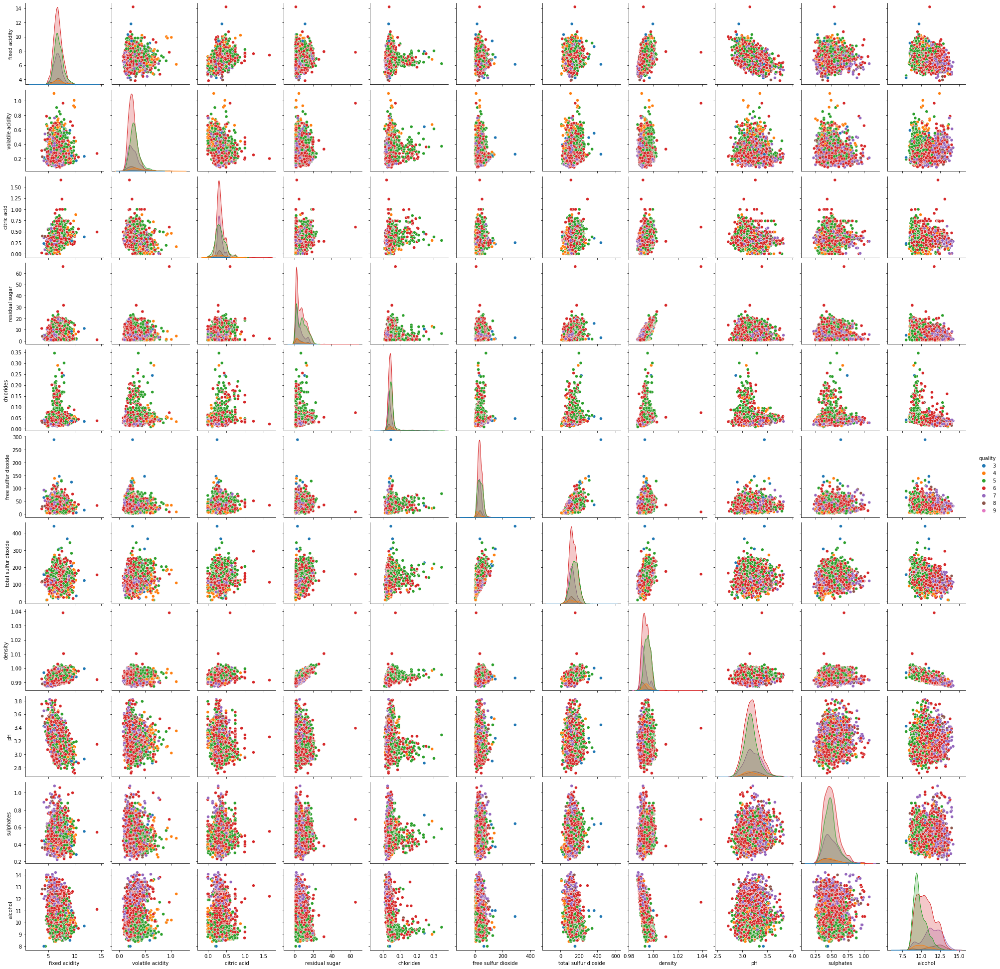

In [9]:
sns.pairplot(df, hue="quality", palette = sns.color_palette("tab10", n_colors=7), plot_kws={'alpha': 1})

Die folgenden Grafiken verdeutlichen, dass die starken Ausreißer teilweise einen vielfach größeren Wert besitzen als die meisten ihres Features. Gerade bei dem Salzgehalt("chlorides"), dem Zucker nach der Gärung("residual sugar") und dem Schwefeldioxid("free sulfur dioxide") ist dies sehr gut zu erkennen. Da diese Werte höchst unwahrscheinlich sind und höchstwahrscheinlich Mess- oder Produktionsfehler darstellen, sollten diese vom Datensatz entfernt werden, da einige Algorithmen stark durch Ausreißer beeinflusst werden.

Ebenso ist anzumerken, dass die Zielvariable höchst unausgeglichen verteilt ist. Es ist deutlich zu erkennen, dass die Klasse $6$ am häufigsten vorkommt und fast gleich viel Datenpunkte beinhaltet wie die zweit und dritthäufigste Klassen $5$ und $7$ zusammen.
Dazu sind die Klassen $\leq 4$ und $\geq 8$ fast gar nicht vertreten.

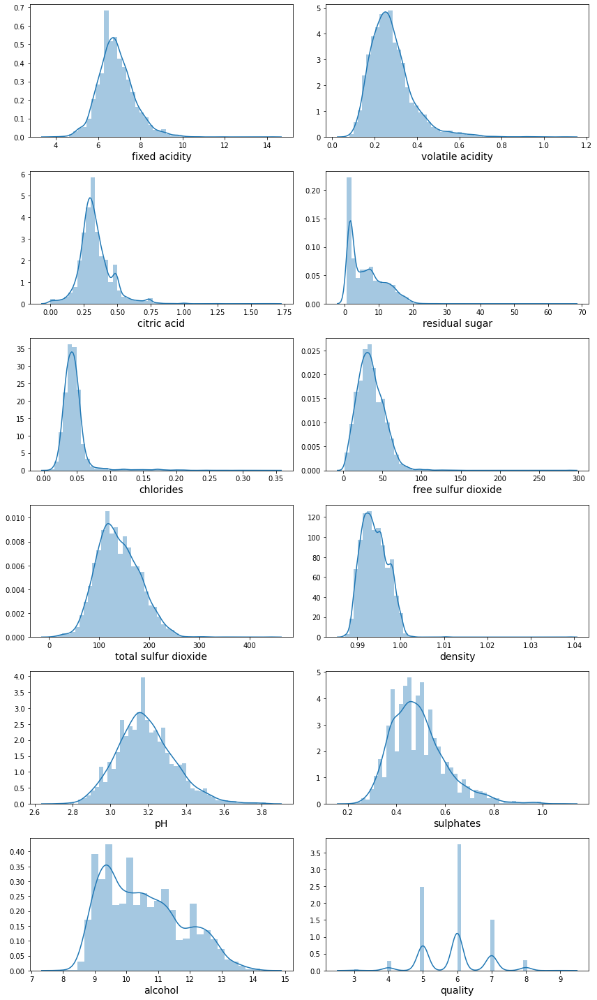

In [10]:
plotEverything_2(df)

## Erkennung und Entfernung von Ausreißer

Wie in der oberen Grafik zu sehen ist, befinden sich im Datensatz einige Ausreißer. Zum Detektieren und Entfernen von Ausreißern werden meist die Standard Deviation Methode und die IQR-Methode verwendet. 

Quelle: 
- <https://towardsdatascience.com/ways-to-detect-and-remove-the-outliers-404d16608dba>

### IQR-Methode

Bei der Interquartile Range Methode, kurz $\mathit{IQR}$, wird zunächst der Wert des $\mathit{IQR}$ bestimmt, welcher durch die Differenz des 3. und 1. Quartils berechnet wird. Als Ausreißer werden in der Regel Datenpunkte mit Werten von $1.5*\mathit{IQR}$ oberhalb des oberen Quartils oder unterhalb des unteren Quartils bezeichnet.

Quellen:
- <https://de.khanacademy.org/math/statistics-probability/summarizing-quantitative-data/box-whisker-plots/a/identifying-outliers-iqr-rule>
- <https://towardsdatascience.com/ways-to-detect-and-remove-the-outliers-404d16608dba>

In [11]:
def remOutliers_IQR(x):
    """Entfernung von Ausreißern im Datensatz mit der IQR-Methode 
    
    Args:
        x (pandas.DataFrame): DatenFrame ohne Zielvariable
        
    Returns:
        x (pandas.DataFrame): DatenFrame ohne Ausreißer
    """
    print("Entfernung von Ausreißern mit der IQR Methode\nShape des Datenframes vor der Anwendung",x.shape)
    
    Q1 = x.quantile(0.25)
    Q3 = x.quantile(0.75)
    IQR = Q3 - Q1
    x = x[~((x < (Q1 - 1.5 * IQR)) |(x > (Q3 + 1.5 * IQR))).any(axis=1)]
    
    print("Shape des Datenframes nach der Anwendung",x.shape)
    
    return x

In [12]:
iqr_df = remOutliers_IQR(df.drop("quality",axis=1))
iqr_df = pd.merge(iqr_df, df["quality"], left_index=True, right_index=True)
iqr_df.reset_index(drop=True, inplace=True)

Entfernung von Ausreißern mit der IQR Methode
Shape des Datenframes vor der Anwendung (4898, 11)
Shape des Datenframes nach der Anwendung (4015, 11)


Mit der $\mathit{IQR}$-Methode werden $883$ Datenpunkte als Ausreißer definiert.

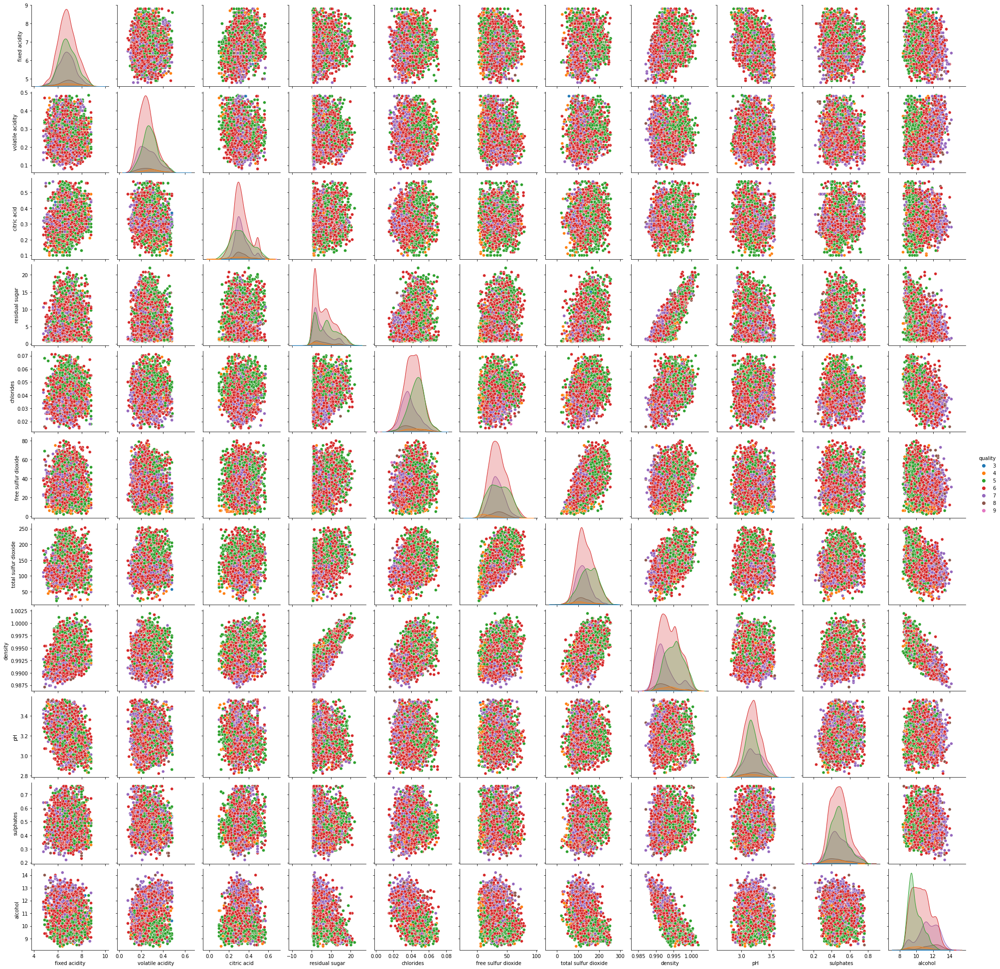

In [13]:
sns.pairplot(iqr_df, hue="quality", palette = sns.color_palette("tab10", n_colors=7), plot_kws={'alpha': 1})

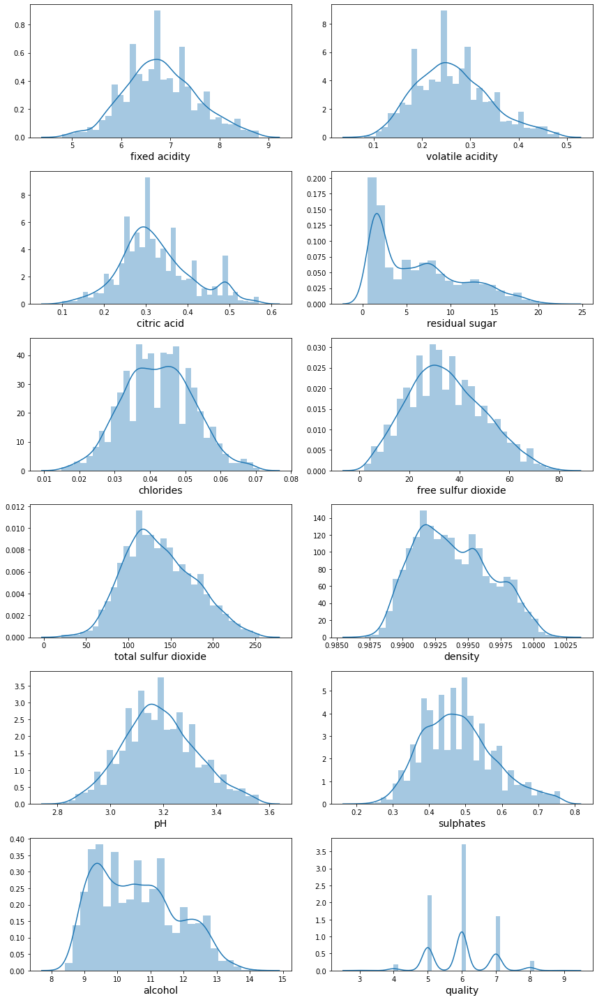

In [14]:
plotEverything_2(iqr_df)

### Standard Deviation Methode

Bei der Standard Deviation Methode werden mit Hilfe der Standardabweichung und dem Mean Ausreißer identifiziert. Dabei wird der Z-Score wie folgt berechnet:

$$z =\frac{x_i-\mu}{\sigma}$$


In einer Normalverteilung ist davon auszugehen, dass $\mathit{3*\sigma}\;\;$ 99.73% aller Werte enthalten sind. Werte darüber werden in der Regel als Ausreißer angesehen.

<!-- Warum wird die Schwelle zscore < 3 verwendet?

"A factor k of 3 or more can be used to identify values that are extreme outliers or “far outs” when described in the context of box and whisker plots." -->

Quellen:
- <https://machinelearningmastery.com/how-to-use-statistics-to-identify-outliers-in-data/>

In [15]:
def remOutliers_ZScore(x):
    """Entfernung von Ausreißern im Datensatz mit der Standard Deviation Methode
    
    Args:
        x (pandas.DataFrame): DatenFrame ohne Zielvariable
        
    Returns:
        x (pandas.DataFrame): DatenFrame ohne Ausreißer
    """
    print("Entfernung von Ausreißern mit der Z-Score Methode\nShape des Datenframes vor der Anwendung",x.shape)
    
    z = np.abs(stats.zscore(x))
    x = x[(z < 3).all(axis=1)]
    
    print("Shape des Datenframes nach der Anwendung",x.shape)
    
    return x

In [16]:
zscore_df = remOutliers_ZScore(df.drop("quality",axis=1))
zscore_df = pd.merge(zscore_df, df["quality"], left_index=True, right_index=True)
zscore_df.reset_index(drop=True, inplace=True)

Entfernung von Ausreißern mit der Z-Score Methode
Shape des Datenframes vor der Anwendung (4898, 11)
Shape des Datenframes nach der Anwendung (4502, 11)


Mit der Standard Deviation Methode werden $396$ Datenpunkte als Ausreißer definiert.

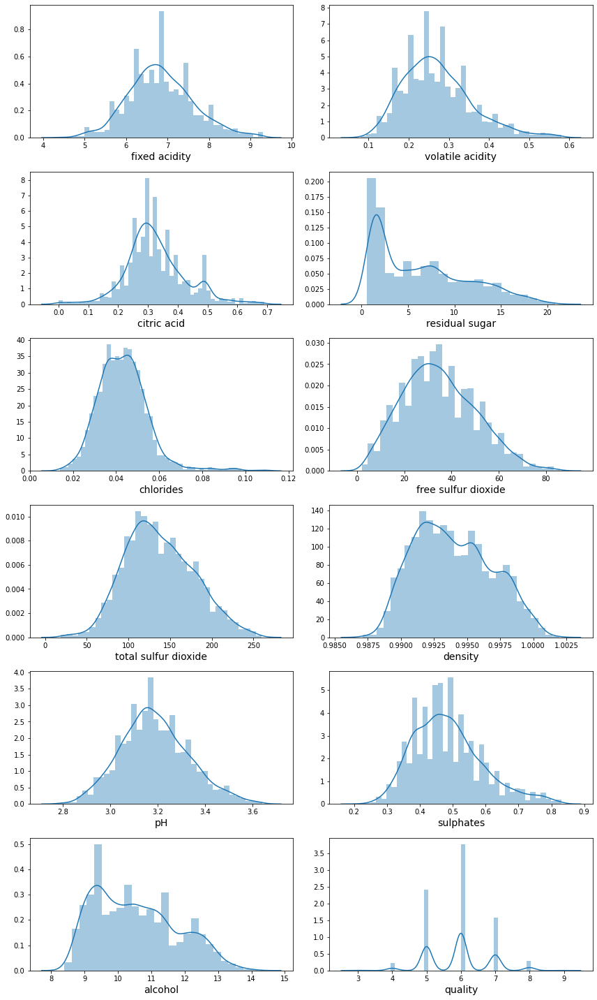

In [17]:
plotEverything_2(zscore_df)

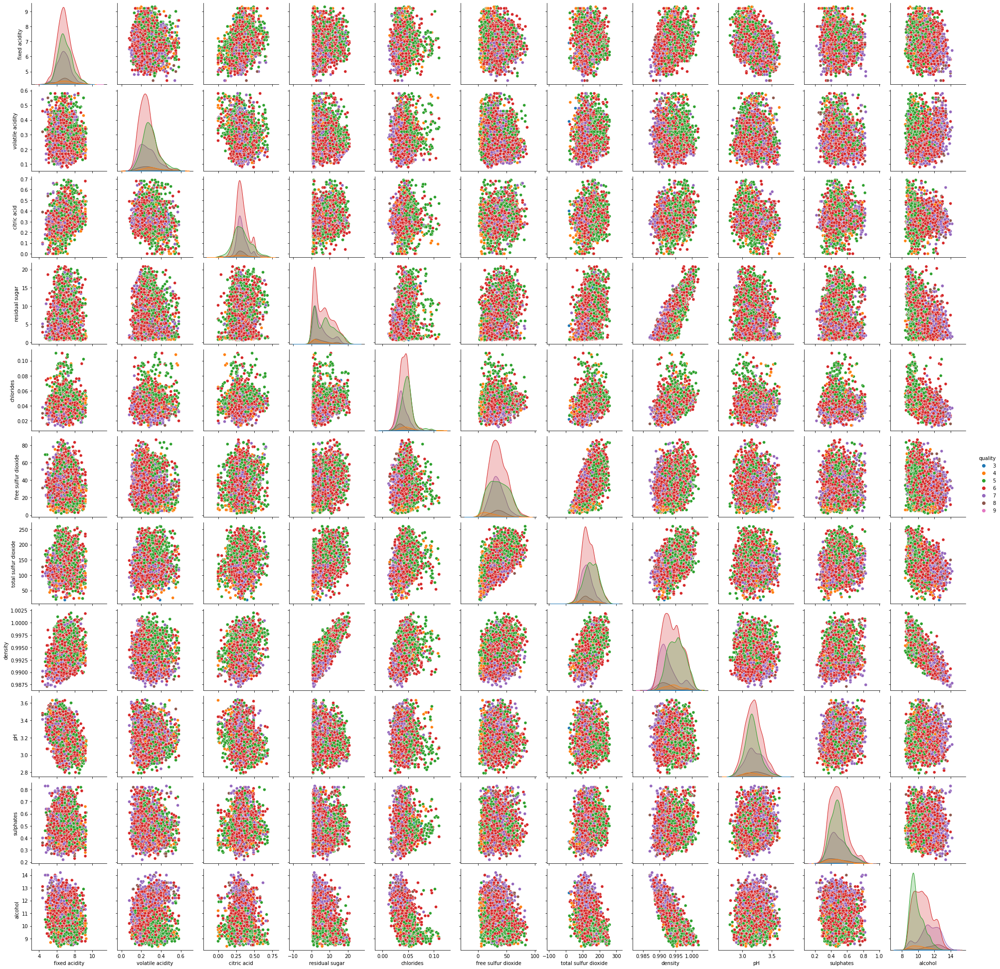

In [18]:
sns.pairplot(zscore_df, hue="quality", palette = sns.color_palette("tab10", n_colors=7), plot_kws={'alpha': 1})

### Wahl der Ausreißer-Methode

Sowohl bei der Standard Deviation Methode, als auch bei der $\mathit{IQR}$-Methode wurden die starken Ausreißer im Datensatz erkannt und eliminiert.
Die $\mathit{IQR}$-Methode hat 883 Datenpunkte eliminiert und den Datensatz stärker beschnitten als die Standard Deviation Methode mit 396 Datenpunkten. Aus den Grafiken ist zu erkennen, dass beide Methoden die Ausreißer effektiv beseitigen und beide Methoden eine legitime Wahl für die Entfernung der Ausreißer darstellen. Für den weiteren Verlauf wurde sich für die Standard Deviation Methode entschieden, da dieser alle Ausreißer erkennt und weniger Datenpunkte als die $\mathit{IQR}$-Methode entfernt.

In [19]:
df = zscore_df

## Logarithmierung der Features

Für einige Machine Learning Algorithmen ist es vorteilhaft, wenn Features einer Normalverteilung folgen. Dies führt dazu, dass die Kostenfunktion den Fehler der Vorhersagen besser minimiert.

Wie in der Grafik zu sehen, sind einige Features, wie zum Beispiel das Feature "residual sugar", nicht normalverteilt und stark in eine Richtung verzerrt. Durch das Logarithmieren dieser Features lassen sich die Datenpunkte mehr zu einer Normalverteilung transformieren. Diese Transformation werden für die Features "residual sugar" und "alcohol" angewendet.

Quellen:
- <https://www.dummies.com/programming/big-data/data-science/transforming-distributions-machine-learning/>
- <https://medium.com/@ODSC/transforming-skewed-data-for-machine-learning-90e6cc364b0>




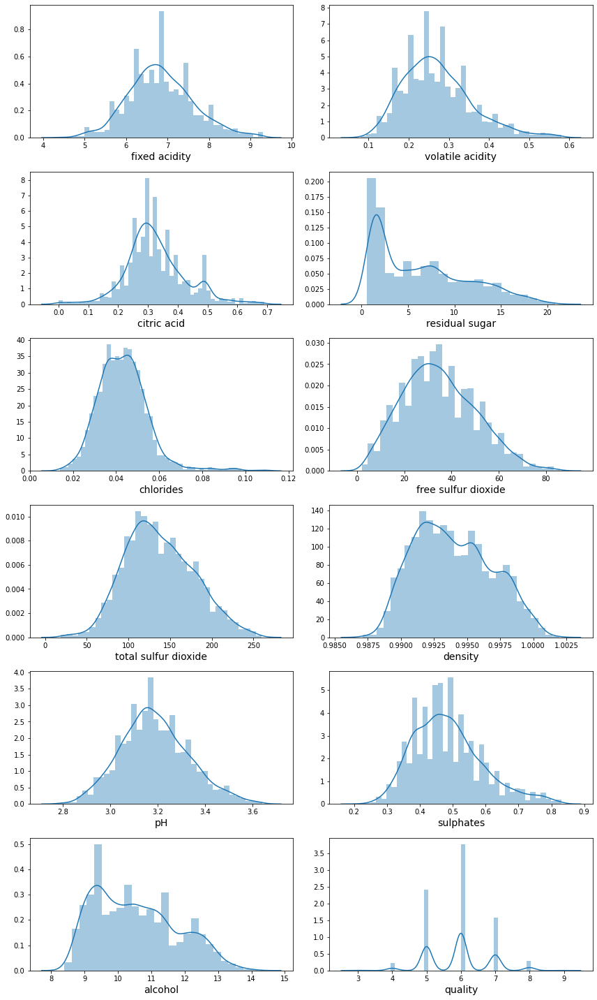

In [20]:
plotEverything_2(df)

In [21]:
for name in ["alcohol", "residual sugar"]:
    df[name+'_Logarithm'] = df[name].apply(lambda x : np.log(x))

Nach der Logarithmierung gleichen die Features eher einer Normalverteilung.

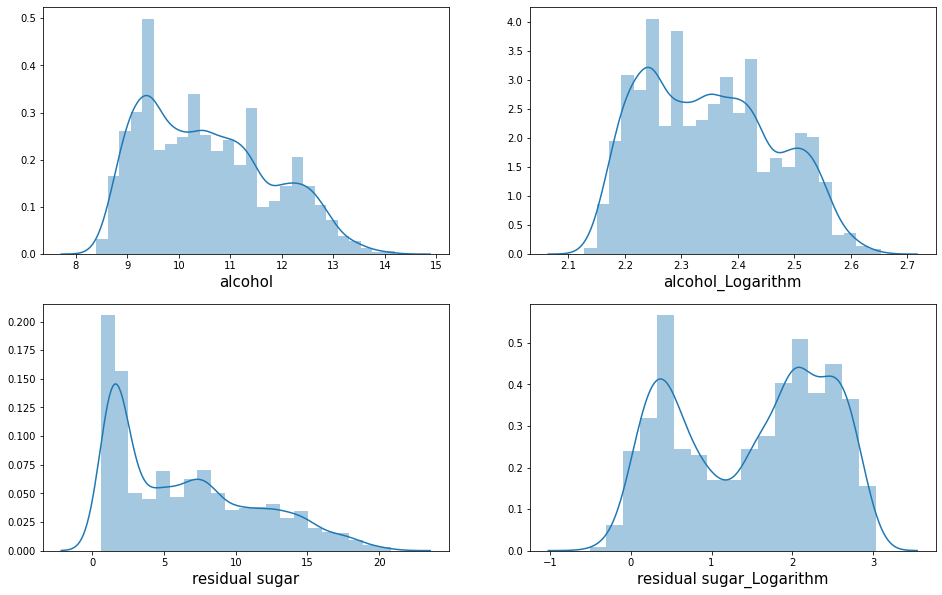

In [22]:
plot_logchanges(df)

## Aufteilung in Trainings- und Testdaten

Die Aufteilung der Daten in Trainings- und Testdatensätze wird mit dem Train_test_split von Scikit-Learn durchgeführt. Es werden $25\%$ der Daten dem Testdatensatz zugesprochen. Dieser Datensatz wird während dem gesamten Training nicht beachtet. Anhand dem Testdatensatz werden am Ende das optimierte Modell auf die während dem Training ungesehenen Daten evaluiert.
Die Aufteilung wird mit dem oben definierten Seed durchgeführt, um die Ergebnisse reproduzierbar zu machen. Die Daten werden während der Aufteilung gemischt und statifiziert getrennt. Stratifizierte Aufteilung bedeutet, dass sich sowohl in dem Trainings- als auch im Testdatensatz die gleiche prozentuale Aufteilung der Zielvariable Weinqualität befinden.

In [23]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(df.index, df['quality'], test_size=0.25, random_state=seed, shuffle=True, stratify=df['quality'])

train_df = df.iloc[X_train]
test_df = df.iloc[X_test]

In [24]:
train_df

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,alcohol_Logarithm,residual sugar_Logarithm
2181,7.0,0.16,0.26,7.3,0.047,30.0,220.0,0.99622,3.38,0.58,10.1,6,2.312535,1.987874
3927,7.2,0.22,0.35,5.5,0.054,37.0,183.0,0.99474,3.08,0.50,10.3,5,2.332144,1.704748
728,8.1,0.17,0.44,14.1,0.053,43.0,145.0,1.00060,3.28,0.75,8.8,8,2.174752,2.646175
4173,6.4,0.24,0.27,1.5,0.040,35.0,105.0,0.98914,3.13,0.30,12.4,6,2.517696,0.405465
2726,6.0,0.32,0.30,1.3,0.025,18.0,112.0,0.98802,3.07,0.64,13.3,7,2.587764,0.262364
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2406,6.8,0.19,0.23,5.1,0.034,71.0,204.0,0.99420,3.23,0.69,10.1,5,2.312535,1.629241
2260,6.3,0.18,0.22,1.5,0.043,45.0,155.0,0.99238,3.19,0.48,10.2,5,2.322388,0.405465
1927,7.1,0.22,0.32,16.9,0.056,49.0,158.0,0.99980,3.37,0.38,9.6,6,2.261763,2.827314
2855,5.9,0.33,0.32,8.1,0.038,9.0,34.0,0.99110,3.22,0.36,12.7,7,2.541602,2.091864


In [25]:
test_df

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,alcohol_Logarithm,residual sugar_Logarithm
2632,6.2,0.21,0.26,13.10,0.050,59.0,150.0,0.99772,3.31,0.46,9.0,5,2.197225,2.572612
2665,7.1,0.27,0.28,1.25,0.023,3.0,89.0,0.98993,2.95,0.30,11.4,4,2.433613,0.223144
2150,7.6,0.48,0.37,1.20,0.034,5.0,57.0,0.99256,3.05,0.54,10.4,3,2.341806,0.182322
3701,7.4,0.16,0.27,15.50,0.050,25.0,135.0,0.99840,2.90,0.43,8.7,7,2.163323,2.740840
3104,7.7,0.46,0.18,3.30,0.054,18.0,143.0,0.99392,3.12,0.51,10.8,6,2.379546,1.193922
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,6.3,0.23,0.21,5.10,0.035,29.0,142.0,0.99420,3.36,0.33,10.1,7,2.312535,1.629241
583,6.2,0.24,0.29,13.30,0.039,49.0,130.0,0.99520,3.33,0.46,11.0,8,2.397895,2.587764
1664,7.0,0.24,0.25,1.70,0.042,48.0,189.0,0.99200,3.25,0.42,11.4,6,2.433613,0.530628
1112,6.8,0.18,0.37,1.50,0.027,37.0,93.0,0.99200,3.30,0.45,10.8,6,2.379546,0.405465


### Speichern des Datensatzes

In [26]:
train_df.to_csv("data/train_weisswein_preprocessed.csv",sep=';',index=False)
test_df.to_csv("data/test_weisswein_preprocessed.csv",sep=';',index=False)

## Datenanalyse

### Korrelationsmatrix

Mit Hilfe der Korrelationsmatrix lassen sich Korrelationen zwischen den Features und den Features mit der Zielvariablen darstellen. Mit Blick auf die Zielvariable "quality" erkennt man eine moderate Korrelation zu den Features "alcohol", "density" und "chlorides". Daraus lässt sich herleiten, dass diese Features einen höheren Einfluss auf die Vorhersage unserer Modelle nehmen werden.
Allerdings sollte man bei einigen Algorithmen Korrelationen zwischen Features vermeiden. Multikollinearität zwischen Features macht die Schätzung des Regressionskoeffizienten instabil und sie wird ungenauer.

Quellen:
- <https://de.wikipedia.org/wiki/Multikollinearit%C3%A4t>
- <https://magoosh.com/statistics/pearson-correlation-coefficient/>
- <https://www.accountingcoach.com/blog/what-is-the-coefficient-of-correlation>

In [27]:
correlation_matrix = train_df.corr()
correlation_matrix

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,alcohol_Logarithm,residual sugar_Logarithm
fixed acidity,1.000000,-0.046495,0.289624,0.076430,0.082431,-0.026143,0.067661,0.253869,-0.394528,-0.028987,-0.113803,-0.088480,-0.109349,0.059403
volatile acidity,-0.046495,1.000000,-0.160668,0.057252,0.017185,-0.071575,0.098533,-0.010702,-0.033185,-0.035661,0.084213,-0.128470,0.070793,0.101971
citric acid,0.289624,-0.160668,1.000000,0.087733,0.036582,0.127887,0.124891,0.138359,-0.152483,0.067582,-0.060464,0.006184,-0.062888,0.072569
residual sugar,0.076430,0.057252,0.087733,1.000000,0.255597,0.343204,0.410051,0.838573,-0.195250,-0.018294,-0.478968,-0.110791,-0.493436,0.938769
chlorides,0.082431,0.017185,0.036582,0.255597,1.000000,0.121873,0.332957,0.469893,-0.031905,0.079481,-0.518506,-0.313374,-0.521323,0.223371
free sulfur dioxide,-0.026143,-0.071575,0.127887,0.343204,0.121873,1.000000,0.622337,0.343954,-0.008545,0.079742,-0.269085,0.015068,-0.274254,0.347809
total sulfur dioxide,0.067661,0.098533,0.124891,0.410051,0.332957,0.622337,1.000000,0.547046,0.024808,0.159143,-0.461150,-0.171947,-0.466925,0.422419
density,0.253869,-0.010702,0.138359,0.838573,0.469893,0.343954,0.547046,1.000000,-0.081709,0.092243,-0.815035,-0.318027,-0.820908,0.772972
pH,-0.394528,-0.033185,-0.152483,-0.195250,-0.031905,-0.008545,0.024808,-0.081709,1.000000,0.169218,0.101405,0.100540,0.110064,-0.170065
sulphates,-0.028987,-0.035661,0.067582,-0.018294,0.079481,0.079742,0.159143,0.092243,0.169218,1.000000,-0.046919,0.036664,-0.044199,-0.021165


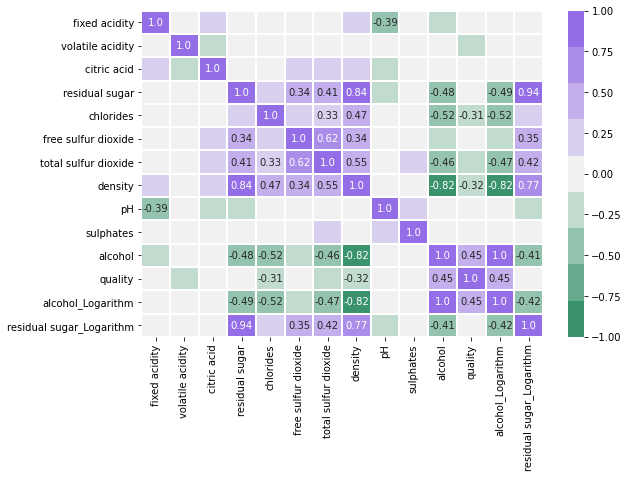

In [28]:
plot_correlationmatrix(train_df, threshold = 0.3)

In [29]:
correlation_matrix['quality'].sort_values(ascending=False)

quality                     1.000000
alcohol                     0.452146
alcohol_Logarithm           0.447331
pH                          0.100540
sulphates                   0.036664
free sulfur dioxide         0.015068
citric acid                 0.006184
residual sugar_Logarithm   -0.069520
fixed acidity              -0.088480
residual sugar             -0.110791
volatile acidity           -0.128470
total sulfur dioxide       -0.171947
chlorides                  -0.313374
density                    -0.318027
Name: quality, dtype: float64

### Auswahl von Features anhand der Korrelationsmatrix

Zur Minimierung des Problems der Multikollinearität werden einige Features eliminiert. Man erkennt, dass das Feature "alcohol", bzw dessen logarithmierte Form die größte Korrelation zur Zielvariable besitzt. Als Schwellenwert der Korrelation zwischen Features wurde 0.3 gewählt. Durch die Wahl des Features "alcohol" elimieren wir dadurch die Features "total sulfure dioxide", "residual sugar" und dessen logarithmierte Form, "chlorides" und "density". Die nächstgrößte Korrelation der verbleibenden Features finde sich in "volatile acidity". Dieses Feature besitzt keine Korrelationen über unserem Schwellenwert, wodurch keine anderen Features eliminiert werden. Nach diesem Schema wurden die Features "pH", "sulphates" und "citric acid" gewählt und das Feature "fixed acidity" ebenfalls eliminiert. 

Daraus erfolgt die Liste folgender Features für den Datensatz der Feature Selection:

- "alcohol" / "alcohol_Logarithm"
- "volatile acidity"
- "pH"
- "sulphates"
- "citric acid"

Im Laufe des Projekts wird sowohl ein SVR Modell mit dem gesamten Datensatz und ein SVR Modell mit dem Datensatz der Feature Selection trainiert und anschließend evaluiert. 

#### Darstellung der Features mit höchster Korrelation untereinander

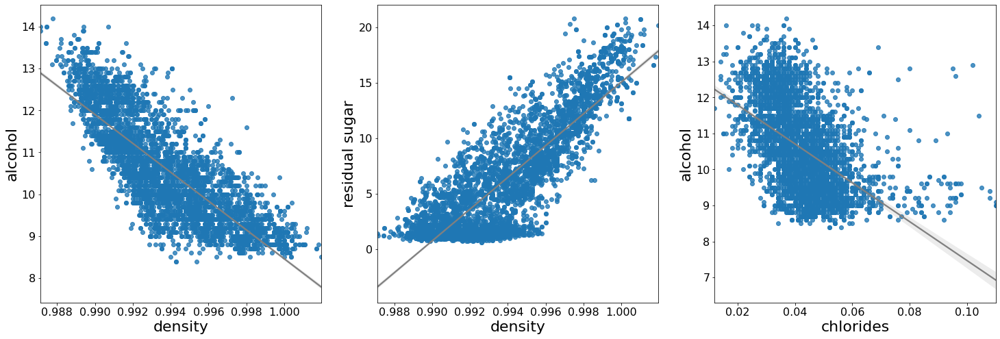

In [30]:
plot_correlatedfeatures()

#### Darstellung des Features mit höchster Korrelation zur Zielvariablen:

Eine mäßig-starke Korrelation hat das Feature Alkohol zur Zielvariablen Qualität.
Dies wirkt sich positiv auf das spätere Modell aus, da das Feature dadurch einen besseren Informationsgewinn hat.

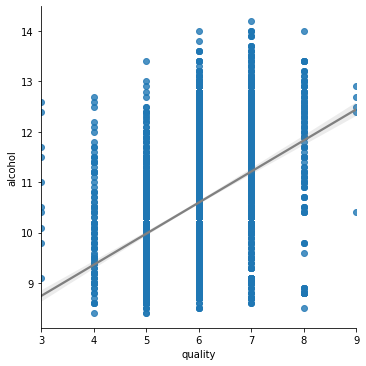

In [31]:
sns.lmplot(x="quality", y="alcohol", data=df, line_kws={'color': 'grey'})

### Funktion zum Laden der Datensätze

In [32]:
def get_datasets(logarithm = False, feature_selection = False):
    """Laden der Datensätze
    
    Args:
        logarithm (bool): Logarithmierte Features anstelle der normalen verwenden
        feature_selection (bool): Nur selektierte Features des Datensatzes laden
        
    Returns:
        train_df (pd.DataFrame): Trainingsdatensatz
        test_df (pd.DataFrame): Testdatensatz
    """
    train_df = pd.read_csv('data/train_weisswein_preprocessed.csv',sep=";")
    test_df = pd.read_csv('data/test_weisswein_preprocessed.csv',sep=";")
    
    if feature_selection:
        columns = ["alcohol", "alcohol_Logarithm", "pH", "volatile acidity", "sulphates", "citric acid", "quality"]
        
        if logarithm:
            columns.remove("alcohol")
            
        else:
            columns.remove("alcohol_Logarithm")
        
    else:
        columns = list(train_df.columns)
        
        if logarithm:
            columns.remove("alcohol")
            columns.remove("residual sugar")
            
        else:
            columns.remove("alcohol_Logarithm")
            columns.remove("residual sugar_Logarithm")
        
    return train_df[columns], test_df[columns]
        

## Skalierung

In Machine Learning ist die Skalierung von Daten ein wichtiger Schritt. Einige Machine Learning Algorithmen performen besser, wenn sie sie eine ähnliche Größenordnung der Einheiten vorweisen. Dies liegt an der Schrittgröße, die im Minimierungsverfahren gebraucht wird. Bei unterschiedlicher Größenordnung würde man pro Einheit eine Schrittgröße benötigen.
Als Skaliermethoden werden meist eine MinMax-Skalierung oder eine Skalierung anhand der Standardabweichung bevorzugt angewandt.
Dabei bietet es sich an, die Funktionen StandardScaler() und MinMaxScaler() von Scikit-Learn zu verwenden.
Diese zwei Skaliermethoden werden im Laufe des Jupyter Notebooks verglichen, indem sie für den Support Vector Regressor als Hyperparameter mitgegeben werden. Beim Random Forest Regressor macht eine Skalierung keinen Sinn, da dies kein distanzbasiertes Modell ist.

Die Skalierung wird pro Training in der Kreuzvalidierung durchgeführt. So wird bei jedem neuen Training zunächst die Scikit-Learn-Funktionen mit den Trainingsdaten trainiert und anschließend der Trainings- und Validierungsdatensatz mit den Scikit-Learn-Funktionen skaliert. 

Quellen:
- Machine Learning for Intelligence Systems Prof. Dr. Markus Schneider
- <https://towardsdatascience.com/all-about-feature-scaling-bcc0ad75cb35>

# Machine Learning Modelle

Da die Aufgabe - die Bestimmung der Weinqualität - eine ordinale Regression ist, werden Regressionsalgorithmen benötigt.

## Support Vector Regressor Trainingsfunktion

Eins der Machine Learning Modelle, welche wir verwenden ist ein Support Vektor Regressor(SVR). Es ist eine Version, der in der Vorlesung behandelten Support Vektor Maschine. Diese Version wird bei Regressionsproblemen angewandt.

Mit 10.000 Datenpunkte gilt ist Datensatz recht klein und somit kann die libsvm Implementation ohne Bedenken verwendet werden. Diese Implementierung bietet im Gegensatz zur linearen SVR verschiedene Kernel.
Bei größeren Datensätzen mit mehreren zehntausend Datenpunkten steigt die Komplexität mehr als quadratisch an.

Da die Scikit-Learn-Implementierung von SVR eine Vielzahl an Parametern besitzt, müssen die korrekten Parameter zunächst mit einem Trainingprozess bestimmt werden.

Die Suche der besten Parameterkombination erfolgt mittels Gridsearch. Da Gridsearch eine Komplexität von $\mathcal{O}(k^n)$ Möglichkeiten besitzt, muss vorab eine Auswahl getroffen werden, welche Parameter ausführlich optimiert werden.

SVR selbst besitzt nur zwei freie Parameter.
- Epsilon, welches das Epsilon Band definiert, in welchem falsch bewertete Datenpunkte nicht bestraft werden.
- C, der Regulisierungsparameter. Die Stärke der Regularisierung ist invers proportional zu C.

Nach vorherigen Tests stellten sich die Daten nicht als linear seperabel heraus. Diese Implemenation verwendet den Radial Bias Kernel, kurz rbf, da dieser gute Ergebnisse lieferte. Es wurde sich gegen den Polynomial Kernel entschieden, da dieser schlechtere Ergebnisse bei erhöhter Laufzeit lieferte.

Der Radial Bias Kernel besitzt eine zusätliche Variable Gamma, welche optimiert werden kann.
Standardmäßig wird Gamma mit Hilfe der Trainingsdaten bestimmt.  
- Scale, gamma = $\frac{1}{n\_features*X.var()}$
- Auto, gamma = $\frac{1}{n\_features}$

In den neueren Versionen ist der Standardwert für Gamma auf "scale" gesetzt.

Ein weiterer Optimierungsparameter ist das oben genannte Skalieren. Dies wird mittels einer Pipeline umgesetzt.

Daraus ergeben sich vier Parameter welche mit Hilfe des Gridsearchalgorithmus optimiert werden müssen. Die Funktion kann ebenso mit anderen Kerneln verwendet werden, zum Beispiel "sigmoid", "linear" oder "poly". Der Polynomial Kernel besitzt einen eigenen Parameter Grad("degree"), welche anstelle von Gamma optimiert werden würde.

Quellen:
<https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVR.html>

In [34]:
def SupportVectorRegressor_train(X, y, cross_validation = False, hyperparameter = None, n_splits = 3, n_repeats = 1, seed = 42, kernel = "rbf", test_for_professor = False):
    """Trainiert ein SVR Model mit gegebenen Hyperparametern. 
    Falls Cross Validation auf Wahr gesetzt wurde, werden SVR Modelle mit Hilfe einer 
    Datensatzaufteilung durch KFold trainiert um optimale Hyperparameter zu bestimmen.
    
    Args:
        X (np.array): Features des Trainingsdatensatzes
        y (np.array): Labels des Trainingsdatensatz
        cross_validation (bool): Ob Cross Validation verwendet werden soll um Hyperparameter zu bestimmen, 
                                ansonsten wird ein Modell mit den übergebenen Hyperparametern trainiert. Defaults ist False
        hyperparameter (dict oder None): Übergabe der Hyperparameter für das Modell bei cross_validation = True. Defaults ist None
        n_splits (int): Anzahl an Spaltungen für Cross Validation. Defaults ist 3
        n_repeats (n_repeats): Wiederholungen der Cross Validation. Defaults ist 1
        seed (int): Seed für den KFold Algorithmus. Defaults ist 42
        kernel (str): Kernel, welcher von dem SVR Modell verwendet werden soll. Defaults ist "rbf"
        test_for_professor (bool): Test für den Professor/Kommilitonen um schneller zu trainieren. Defaults ist False
        
    Returns:
        cross_validation == True:
            train_config (dict): Ein Array von Objekten, welcher die Hyperparameter und Metriken des Trainings beinhaltet
        cross_validation == False:
            model (object): Das trainierte Model
                
    Raise: 
        ValueError: Falls beim Trainieren eines Modells in dem Hyperparameter Dictionary ein falscher Wert übergeben wurde.
    """
    if cross_validation:
        zeitanfang = time.time()
        train_config = {    
        "kernel":[],
        "epsilon":[],
        "C":[],
        "gamma":[],
        "degree":[],
        "r2score_train":[],
        "mse_train":[],
        "acc_train":[],
        "r2score_val":[],
        "mse_val":[],
        "acc_val":[],
        "scaler":[],
        "time":[],
        }
        
        min_samples_split=np.unique(np.round(np.logspace(1, 6, num=10, base=2)).astype(int))
        
        
        # Default Values, please change
        epsilon = np.arange(0.05, 0.5, 0.05)
        C = np.logspace(-1.5, 1.5, num=30, base=10)
        
        # Manual gamma settings, with auto and scale as the first parameters
        # scale uses 1 / (n_features * X.var())
        # auto uses 1 / n_features.
        gamma = np.logspace(-2, 0, num=5, base=10)
        gamma = ["scale", "auto"]+list(gamma)
        
        # Degree range for use with the poly kernel. The second variable in range is exclusive.
        degree = range(1,4)

        if test_for_professor:
            # Test values to test functionality
            epsilon = np.arange(0.05, 0.1, 0.05)
            C = np.logspace(0, 0.5, num=5, base=10)
            gamma = [0.31622776601683794]
            degree = [3]
        
        # Only the poly kernel uses the degree parameter, so for all other kernels it can be set to one element to reduce permutations.
        if kernel is not "poly":
            degree=[0]
        
        # linear does not use the gamma parameter, so it can be reduced to one entry to reduce permutations.
        if kernel is "linear":
            gamma = ["scale"]
        
        
        scaler = [StandardScaler(),MinMaxScaler()]
        
        cvvr = CrossValidationValueRecorder()
        
        rkf = RepeatedKFold(n_splits=n_splits, n_repeats=n_repeats, random_state=seed)
        
        # Calculating the amount of the length of the cartesian product
        num_train = ProductLength([epsilon, C, gamma, scaler, degree])
        
        # Running the cross validation
        for i,(e,c,g,s,d) in enumerate(itertools.product(epsilon,C,gamma,scaler,degree)):
            print(f'{i+1:5d}/{num_train} {e:.3f} {c:.3f} {g} {str(s):16}', d, end='')
            
            # Insert model specific values
            train_config["epsilon"].append(e)
            train_config["C"].append(c)
            train_config["gamma"].append(g)
            train_config["scaler"].append(s)
            train_config["degree"].append(d)
            train_config["kernel"].append(kernel)
            cvvr.Reset()
            
            trainingTimeBegin = time.time()
            for train_index, val_index in rkf.split(X):
                X_train, X_val = X[train_index], X[val_index] 
                y_train, y_val = y[train_index], y[val_index]
                
                svr = SVR(kernel=kernel, C=c, epsilon=e, gamma=g, degree=d)
                pipe = Pipeline([('scaler', s), ('svc', svr)])
                pipe.fit(X_train,y_train)
                
                model = pipe.fit(X_train, y_train)

                #val
                y_pred = model.predict(X_val)
                cvvr.AddValidationMetric(y_val, y_pred)
                #Train
                y_pred = model.predict(X_train)
                cvvr.AddTrainMetric(y_train, y_pred)
            
            trainingTime = time.time()-trainingTimeBegin
            train_config["time"].append(trainingTime)
            print(' ->',cvvr.GetMSE())
            # Add Scores to evaluate
            cvvr.UpdateConfig(train_config)
        
        processingTime = time.time()-zeitanfang
        print(f"Time Taken {processingTime:.3f}s")
        return train_config
    else:
        if (hyperparameter['gamma'] == "auto" or hyperparameter["gamma"] == "scale"):
            gamma = hyperparameter['gamma']
        else:
            gamma = float(hyperparameter['gamma'])
        
        svr = SVR(kernel = kernel, degree = hyperparameter['degree'], C = hyperparameter['C'], epsilon = hyperparameter['epsilon'], gamma = gamma)
        
        if hyperparameter['scaler'] == "StandardScaler()":
            scaler = StandardScaler()
        elif hyperparameter['scaler'] == "MinMaxScaler()":
            scaler =  MinMaxScaler()
        else:
            raise ValueError(f"Scaler not found please insert \"StandardScaler()\" or \"MinMaxScaler()\" ")
        
        pipe = Pipeline([('scaler', scaler), ('svc', svr)])
        model = pipe.fit(X, y)
        
        return model



## Random Forest Regressor Trainingsfunktion

Entscheidungsbäume sind in der Lage sich sehr gut auf einen Datensatz anzupassen, allerdings weisen sie sehr oft eine hohe Varianz auf und neigen daher sehr stark zum Overfitting. Daher wurde als zweites Modell der Random Forest Regressor gewählt. Dieser besteht aus mehreren unkorrelierten Entscheidungsbäumen. Dadurch wird das Overfitting von Entscheidungsbäumen vermieden und somit eine bessere Generalisierung ermöglicht.

Für das Modell wird der Random Forest Regressor von Scikit-Learn implementiert. Dieser bietet eine Reihe von Parametern welche in der Hyperparameteroptimierung angepasst werden können.
Die optimalen Parameter werden ebenfalls mit dem Gridsearchalgorithmus ermittelt. 

Um der Komplexität des Gridsearchalgorithmus entgegenzuwirken werden Parameter ausgewählt, welche ausführlich optimiert werden. Zuvor wurden durch Tests Parameter ermittelt, welche eine signifikante Änderung für das Training bedeuteten. Parameter, welche eine starke Korrelation aufweisen (zb. min_samples_split und min_samples_leaf) haben einen sehr ähnlichen Effekt auf das Training, weshalb lediglich einer dieser Parameter optimiert wird. 

Aus diesen Gründen werden folgende Parameter in der Hyperparameteroptimierung angewandt:
- max_depth: Maximale Tiefe der Bäume
- min_samples_split: Minimale Anzahl an Datenpunkten, um eine Aufteilung durchgeführen zu dürfen.
- max_features: Anzahl an Features, die für eine Aufteilung betrachtet werden

Die anderen Parameter werden auf Default gesetzt oder auf Werte, die bei zuvor durchgeführten Tests am sinnvollsten erschienen.

In [35]:
def RandomForestRegressor_train(X, y, cross_validation=False, hyperparameter=None, n_splits=3, n_repeats=1, seed=42, test_for_professor = False): 
    """Trainiert ein Random Forest Regressor Model mit gegebenen Hyperparametern. 
    Falls Cross Validation auf Wahr gesetzt wurde, werden RFR Modelle mit Hilfe einer 
    Datensatzaufteilung durch KFold trainiert um optimale Hyperparameter zu bestimmen.
    
    Args:
        X (np.array): Features des Trainingsdatensatzes
        y (np.array): Labels des Trainingsdatensatz
        cross_validation (bool): Ob Cross Validation verwendet werden soll um Hyperparameter zu bestimmen, 
                                ansonsten wird ein Modell mit den übergebenen Hyperparametern trainiert. Defaults ist False
        hyperparameter (dict oder None): Übergabe der Hyperparameter für das Modell bei cross_validation = True. Defaults ist None
        n_splits (int): Anzahl an Spaltungen für Cross Validation. Defaults ist 3
        n_repeats (n_repeats): Wiederholungen der Cross Validation. Defaults ist 1
        seed (int): Seed für den KFold Algorithmus. Defaults ist 42
        test_for_professor (bool): Test für den Professor/Kommilitonen um schneller zu trainieren. Defaults ist False
        
    Returns:
        cross_validation == True:
            train_config (dict): Ein Array von Objekten, welcher die Hyperparameter und Metriken des Trainings beinhaltet
        cross_validation == False:
            model (object): Das trainierte Model
                
    Raise: 
        ValueError: Falls beim Trainieren eines Modells in dem Hyperparameter Dictionary ein falscher Wert übergeben wurde.
    """
    
    if cross_validation:
        zeitanfang = time.time()
        
        train_config = {    
        "n_estimators":[],
        "max_depth":[],
        "min_samples_split":[],
        "min_weight_fraction_leaf":[],
        "ccp_alpha":[],
        "oob_score":[],
        "max_features":[],
        "r2score_train":[],
        "mse_train":[],
        "acc_train":[],
        "r2score_val":[],
        "mse_val":[],
        "acc_val":[],
        "time":[],
        }
        
        n_estimators=[1000]
        max_depth= [i for i in range(1,30,1)]
        min_samples_split=np.unique(np.round(np.logspace(1, 6, num=10, base=2)).astype(int))
        min_weight_fraction_leaf=[0]#is not optimized for time reasons. However, zero is usually best.
        oob_score=[True]#,False] 
        ccp_alpha=[0] #is not optimized for time reasons. However, zero is usually best.
        max_features=['auto', 'sqrt','log2']
        
        if test_for_professor:
            #Test for fast run 
            n_estimators=[1000]
            max_depth=[20,25]
            min_samples_split=[2,4]
            min_weight_fraction_leaf=[0]
            oob_score=[False] 
            ccp_alpha=[0]
            max_features=['auto', 'sqrt']

        cvvr = CrossValidationValueRecorder()
        
        rkf = RepeatedKFold(n_splits=n_splits, n_repeats=n_repeats, random_state=seed)
        
        num_train = ProductLength([n_estimators, max_depth, min_samples_split, min_weight_fraction_leaf,oob_score, ccp_alpha, max_features])
        
        print(f'Step/Maxsteps | Estimator | MaxDepth | MinSampleSplit | Minweightfractionleaf | oobscore | ccpalpha | max_features')
        
        for i,(n_e,md,ms,mw,oob,ccp,mf) in enumerate(itertools.product(n_estimators, max_depth, min_samples_split, min_weight_fraction_leaf, oob_score, ccp_alpha,max_features)):
            print(f'{i+1:5d}/{num_train} {n_e:5d} {md:2d} {ms:2d} {mw:.3f} {oob:.3f} {ccp:.3f} {mf}', end='')

            train_config["n_estimators"].append(n_e)
            train_config["max_depth"].append(md)
            train_config["min_samples_split"].append(ms)
            train_config["min_weight_fraction_leaf"].append(mw)
            train_config["oob_score"].append(oob)
            train_config["ccp_alpha"].append(ccp)
            train_config["max_features"].append(mf)
            
            cvvr.Reset()
            
            trainingTimeBegin = time.time()
            for train_index, val_index in rkf.split(X):
                X_train, X_val = X[train_index], X[val_index] 
                y_train, y_val = y[train_index], y[val_index]
                rfr=RandomForestRegressor(max_depth=md, min_samples_split=ms, min_weight_fraction_leaf=mw, oob_score=oob, ccp_alpha=ccp, random_state=seed, n_jobs=-1, n_estimators=n_e, max_features=mf)
                model = rfr.fit(X_train, y_train)
                
                #val
                y_pred = model.predict(X_val)
                cvvr.AddValidationMetric(y_val, y_pred)
                #Train
                y_pred = model.predict(X_train)
                cvvr.AddTrainMetric(y_train, y_pred)
            
            trainingTime = time.time()-trainingTimeBegin
            train_config["time"].append(trainingTime)
            print(' ->',cvvr.GetMSE())
            # Add Scores to evaluate
            cvvr.UpdateConfig(train_config)
        
        processingTime = time.time()-zeitanfang
        print(f"Time Taken {processingTime:.3f}s")
        return  train_config
    else:
        rfr=RandomForestRegressor(random_state=seed, n_jobs=-1, n_estimators=hyperparameter['n_estimators'], 
                                  max_depth=hyperparameter['max_depth'],min_samples_split=hyperparameter['min_samples_split'], 
                                   min_weight_fraction_leaf=hyperparameter['min_weight_fraction_leaf'],oob_score=hyperparameter['oob_score'],
                                   ccp_alpha=hyperparameter['ccp_alpha'], max_features=hyperparameter['max_features'])
        model = rfr.fit(X, y)
        return model

## Hyperparametersuche der Modelle

Ausführung der Trainingsfunktionen der Modelle. Nach jedem Modelldurchlauf werden die Ergebnisse in eine .csv Datei zwischengespeichert.

## Hyperparametersuche Random Forest Regressor

In [38]:
train_df, test_df = get_datasets(logarithm=True, feature_selection=False)

X_train = train_df.drop("quality",axis=1).values
X_test = test_df.drop("quality",axis=1).values

y_train = train_df["quality"].values
y_test = test_df["quality"].values

In [39]:
train_config = RandomForestRegressor_train(X_train,y_train,cross_validation=True, test_for_professor = test_for_professor)

df = pd.DataFrame.from_dict(train_config)
df = df.sort_values(by=['mse_val'])
if not test_for_professor:
    df.to_csv('results/train_conf_tree.csv',index=False)

Step/Maxsteps | Estimator | MaxDepth | MinSampleSplit | Minweightfractionleaf | oobscore | ccpalpha | max_features
    1/870  1000  1  2 0.000 1.000 0.000 auto -> 0.6246662850329954
    2/870  1000  1  2 0.000 1.000 0.000 sqrt -> 0.6494371022085937
    3/870  1000  1  2 0.000 1.000 0.000 log2 -> 0.6494371022085937
    4/870  1000  1  3 0.000 1.000 0.000 auto -> 0.6246662850329954
    5/870  1000  1  3 0.000 1.000 0.000 sqrt -> 0.6494371022085937
    6/870  1000  1  3 0.000 1.000 0.000 log2 -> 0.6494371022085937
    7/870  1000  1  4 0.000 1.000 0.000 auto -> 0.6246662850329954
    8/870  1000  1  4 0.000 1.000 0.000 sqrt -> 0.6494371022085937
    9/870  1000  1  4 0.000 1.000 0.000 log2 -> 0.6494371022085937
   10/870  1000  1  6 0.000 1.000 0.000 auto -> 0.6246662850329954
   11/870  1000  1  6 0.000 1.000 0.000 sqrt -> 0.6494371022085937
   12/870  1000  1  6 0.000 1.000 0.000 log2 -> 0.6494371022085936
   13/870  1000  1  9 0.000 1.000 0.000 auto -> 0.6246662850329954
   14/870  100

## Hyperparametersuche SVR mit Feature Selection

In [40]:
train_df, test_df = get_datasets(logarithm=True, feature_selection=True)

X_train = train_df.drop("quality",axis=1).values
X_test = test_df.drop("quality",axis=1).values

y_train = train_df["quality"].values
y_test = test_df["quality"].values

In [41]:
# Avaliable Kernels are {‘linear’, ‘poly’, ‘rbf’, ‘sigmoid’}
train_config = SupportVectorRegressor_train(X_train,y_train,cross_validation=True, kernel = "rbf", test_for_professor = test_for_professor)

df = pd.DataFrame.from_dict(train_config)
df = df.sort_values(by=['mse_val'])
if not test_for_professor:
    df.to_csv('results/train_conf_svr_feat_sel.csv',index=False)

    1/3780 0.050 0.032 scale StandardScaler() 0 -> 0.5787432849079324
    2/3780 0.050 0.032 scale MinMaxScaler()   0 -> 0.5749910230560764
    3/3780 0.050 0.032 auto StandardScaler() 0 -> 0.5787432849079449
    4/3780 0.050 0.032 auto MinMaxScaler()   0 -> 0.6812117397796916
    5/3780 0.050 0.032 0.01 StandardScaler() 0 -> 0.676191344770916
    6/3780 0.050 0.032 0.01 MinMaxScaler()   0 -> 0.7451503778890992
    7/3780 0.050 0.032 0.03162277660168379 StandardScaler() 0 -> 0.6160805976136176
    8/3780 0.050 0.032 0.03162277660168379 MinMaxScaler()   0 -> 0.7265186614329805
    9/3780 0.050 0.032 0.1 StandardScaler() 0 -> 0.5740999404684444
   10/3780 0.050 0.032 0.1 MinMaxScaler()   0 -> 0.7024556054607523
   11/3780 0.050 0.032 0.31622776601683794 StandardScaler() 0 -> 0.5895977917688922
   12/3780 0.050 0.032 0.31622776601683794 MinMaxScaler()   0 -> 0.6611517368919119
   13/3780 0.050 0.032 1.0 StandardScaler() 0 -> 0.6473299063870331
   14/3780 0.050 0.032 1.0 MinMaxScaler()   0

## Hyperparametersuche SVR ohne Feature Selection

In [42]:
train_df, test_df = get_datasets(logarithm=True, feature_selection=False)

X_train = train_df.drop("quality",axis=1).values
X_test = test_df.drop("quality",axis=1).values

y_train = train_df["quality"].values
y_test = test_df["quality"].values

In [43]:
# Avaliable Kernels are {‘linear’, ‘poly’, ‘rbf’, ‘sigmoid’}
train_config = SupportVectorRegressor_train(X_train,y_train,cross_validation=True, kernel = "rbf", test_for_professor = test_for_professor)

df = pd.DataFrame.from_dict(train_config)
df = df.sort_values(by=['mse_val'])
if not test_for_professor:
    df.to_csv('results/train_conf_svr.csv',index=False)

    1/3780 0.050 0.032 scale StandardScaler() 0 -> 0.5417756875272429
    2/3780 0.050 0.032 scale MinMaxScaler()   0 -> 0.5316854466803687
    3/3780 0.050 0.032 auto StandardScaler() 0 -> 0.5417756875272429
    4/3780 0.050 0.032 auto MinMaxScaler()   0 -> 0.6885896949658922
    5/3780 0.050 0.032 0.01 StandardScaler() 0 -> 0.6350147002507263
    6/3780 0.050 0.032 0.01 MinMaxScaler()   0 -> 0.7391515282840602
    7/3780 0.050 0.032 0.03162277660168379 StandardScaler() 0 -> 0.5631224105089
    8/3780 0.050 0.032 0.03162277660168379 MinMaxScaler()   0 -> 0.718194108362515
    9/3780 0.050 0.032 0.1 StandardScaler() 0 -> 0.5441232780771921
   10/3780 0.050 0.032 0.1 MinMaxScaler()   0 -> 0.6845473818306503
   11/3780 0.050 0.032 0.31622776601683794 StandardScaler() 0 -> 0.6353615358334851
   12/3780 0.050 0.032 0.31622776601683794 MinMaxScaler()   0 -> 0.6224281808356801
   13/3780 0.050 0.032 1.0 StandardScaler() 0 -> 0.7253388096625284
   14/3780 0.050 0.032 1.0 MinMaxScaler()   0 ->

# Evaluation des Hyperparametertrainings

Im folgenden Kapitel werden die durch Kreuzvalidierung beurteilten Modelle des Random Forest Regressors und der Support Vector Regression untersucht. Das Ziel dieser Evaluation wird sein, die besten Hyperparameter für die jeweiligen Algorithmen zu wählen und für jeden Algorithmus ein adäquates Modell zu trainieren. Diese Modelle werden auf die Testdaten angewandt und sollten damit auch eine gute Generalisierung erreichen.


## Random Forest Regressor

Im Nachfolgenden werden die Ergebnisse des Hyperparametertrainings für den Random Forest Regressor dargestellt.
Man sieht hier deutlich, dass wir den Besten Mean Squared Error auf den Validierungsdaten bei einer Baumtiefe (max_depth) von 23 und einer minimalen Anzahl an Spaltungen (min_sample_split) von 2 erreichen.

Bei den Funktionen zur Berechnung der maximalen Anzahl an Features, die für eine Aufteilung betrachtet werden, stechen zwei Funktionen heraus.
Dies wäre zum Einen die Wurzelfunktion (sqrt), welche von Scikit-Learn durch $round(sqrt(11))$ berechnet wird und zum anderen die Funktion des Logarithmus Dualis, welche durch Scikit-Learn mit $round(log2(11))$ dargestellt wird.

Bei 11 Features ergibt sich, dass die beide Funktionen dasselbe Ergebnis liefern:

$round(log2(11)) = round(sqrt(11))$ 

Dies ist uns leider erst nach dem Durchlauf der Hyperparameter aufgefallen. Im Laufenden werden wir mit der Wurzelfunktion weiterarbeiten.

In [36]:
df = pd.read_csv('results/train_conf_tree.csv')  
df=df.sort_values(by=['mse_val'])
df.head(5)

,n_estimators,max_depth,min_samples_split,min_weight_fraction_leaf,ccp_alpha,oob_score,max_features,r2score_train,mse_train,acc_train,r2score_val,mse_val,acc_val,time
0,1000,23,2,0,0,True,sqrt,0.932157,0.051272,0.958235,0.490865,0.384372,0.649588,6.287473
1,1000,23,2,0,0,True,log2,0.932157,0.051272,0.958235,0.490865,0.384372,0.649588,6.258244
2,1000,22,2,0,0,True,sqrt,0.931837,0.051515,0.957938,0.490420,0.384711,0.651959,6.288148
3,1000,22,2,0,0,True,log2,0.931837,0.051515,0.957938,0.490420,0.384711,0.651959,6.350337
4,1000,29,2,0,0,True,sqrt,0.932390,0.051096,0.957642,0.490034,0.385001,0.648997,6.302474


Die dreidimensionalen Darstellungen zeigt die Veränderung des Mean Squared Errors mit verändernder maximaler Tiefe (max_depth) und minimaler Aufteilung der Features (min_sample_split).

Zur Ermittlung der optimalen Baumtiefe wird folgend eine zweidimensionale Darstellung verwendet, da hier das Optimum besser erkennbar ist.

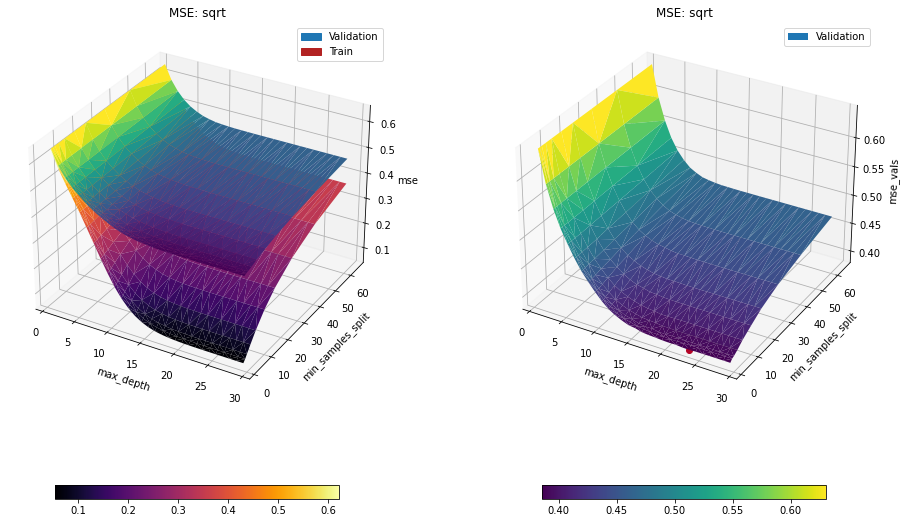

In [37]:
plot_rfr3d()


In den beiden unterliegenden Grafiken wird jeweils der Mean Squared Error über die Abhängigkeit der maximale Tiefe und der minimalen Aufteilung der Features dargestellt.

In der ersten Grafik wird dabei die maximale Tiefe der Bäume auf 23 gesetzt und die max_feature Methode sqrt verwendet.
Wie bereits oben erläutert, bildet diese Kombination die besten Ergebnisse unser Hyperparametersuche ab.
Ab einer Tiefe von 20 wird hier erkennbar, dass sich die Ergebnisse kaum verbessern. Das Optimum liegt hierbei bei einer Baumtiefe von 23.
Zudem ist erkennbar, dass sich die Laufzeit bei höherer maximaler Tiefe nicht mehr stark verändert. Dies liegt daran, dass bei einer Tiefe von 23 die maximale Tiefe bereits erreicht ist.

In der zweiten Grafik wird eine minimale Aufteilung der Features von zwei und die max_feature Methode sqrt verwendet.
Hier wird deutlich, dass die kleinste Aufteilung von 2 Featuren die besten Ergebnisse Erzielen.

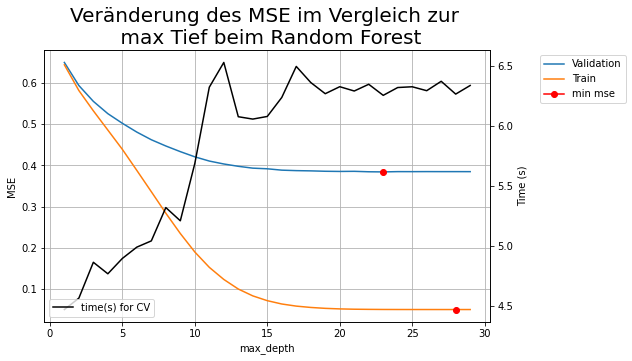

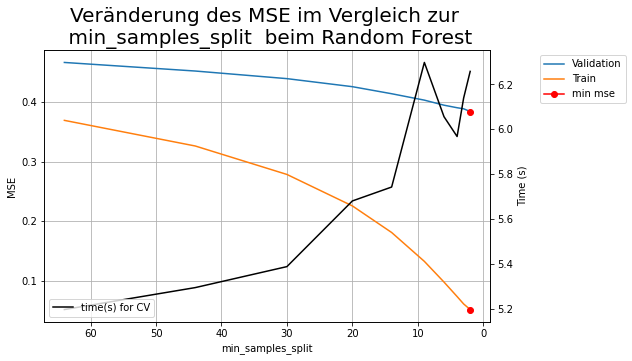

In [38]:
plot_rfr2d_2()

### Auswahl des Random Forest Regressors:

Durch die vorherige Evaluation der verschiedenen Modelle ergibt sich, dass der Random Forest Regressor bei einer maximalen Tiefe größer 20  und einer minimalen Aufteilung der Features von 2 die besten Ergebnisse erzielt.
Da es ersichtlich ist, dass das Model mit dem geringesten MSE auf die Validationsdaten hier die beste Wahl darstellt, wird für die maximale Tiefe der Wert 23 festgelegt.

Im Folgenden werden die von uns gewählten Hyperparametern mit ihren erzielten Metriken dargestellt: 

In [39]:
# Hyperparameter des ausgewählten Modells

df = pd.read_csv('results/train_conf_tree.csv')  
df = df.sort_values(by=['mse_val'])

best_config_tree = df.iloc[0].to_dict()

In [40]:
best_config_tree

{'n_estimators': 1000,
 'max_depth': 23,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0,
 'ccp_alpha': 0,
 'oob_score': True,
 'max_features': 'sqrt',
 'r2score_train': 0.9321572452223404,
 'mse_train': 0.0512718609771633,
 'acc_train': 0.95823472695263,
 'r2score_val': 0.4908645412701974,
 'mse_val': 0.3843721213738536,
 'acc_val': 0.6495883165581211,
 'time': 6.287473440170288}

## SVR


### SVR ohne Feature Selection

Im folgenden Kapitel werden die Ergebnisse der Support Vector Regression ohne Anwendung der Feature Selection evaluiert, um anschließend die Hyperparameter für ein adäquates Modell wählen zu können.

An der Ausgabe der Hyperparameter und deren Validierungs-/Trainingsergebnisse sieht man sehr gut, dass der Durchlauf des Support Verctor Regressors mit der Skalierfunktion StandardScaler die besten Ergebnisse erzielt.



In [41]:
df = pd.read_csv('results/train_conf_svr.csv')  
df=df.sort_values(by=['mse_val'])
df.head(5)

,kernel,epsilon,C,gamma,degree,r2score_train,mse_train,acc_train,r2score_val,mse_val,acc_val,scaler,time
0,rbf,0.25,1.429461,0.31622776601683794,0,0.808053,0.145069,0.898253,0.385928,0.463565,0.605451,StandardScaler(),2.750675
1,rbf,0.30,1.429461,0.31622776601683794,0,0.791919,0.157263,0.901659,0.385446,0.463923,0.607228,StandardScaler(),2.621991
2,rbf,0.25,1.126482,0.31622776601683794,0,0.776587,0.168851,0.870557,0.385359,0.464009,0.605155,StandardScaler(),2.657069
3,rbf,0.20,1.126482,0.31622776601683794,0,0.787608,0.160522,0.865225,0.385237,0.464100,0.599230,StandardScaler(),2.794530
4,rbf,0.20,1.429461,0.31622776601683794,0,0.820345,0.135780,0.892772,0.384590,0.464578,0.606636,StandardScaler(),2.889254


In den beiden unterliegenden Grafiken wird jeweils der Mean Squared Error über die Abhängigkeit der Regularisierungskonstante C und dem Parameter Epsilon dargestellt.

Es ist wie oben erneut erkennbar, dass der StandardScaler bessere Ergebnisse als der MinMaxScaler erreicht. Aus diesem Grund werden hier bereits ausschließlich diese Modelle betrachtet.

In der ersten Grafik ist deutlich zu erkennen, dass die Zeitkomplexität mit größer werdendem Epsilon linear abnimmt. 

Die zweite Grafik zeigt, dass der ideale Mean Squared Error bei einer Regularisierungskonstante von etwa 1,429 liegt.
Da die Regularisierung im Funktionsaufruf von Scikit-Learn proportional invers zu C ist, bedeutet dies für unser Modell, dass die Toleranz gegenüber größerer Gewichte zu besseren Ergebnissen führt.

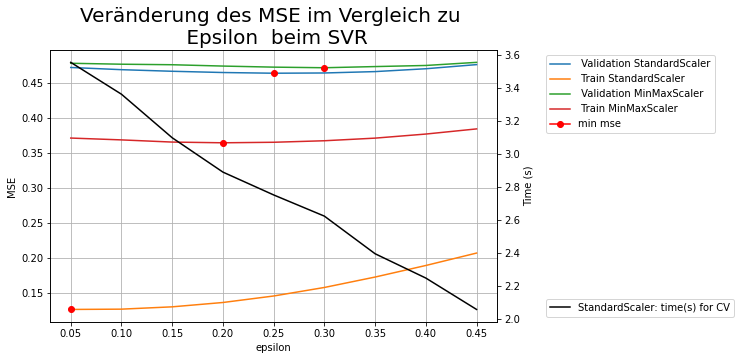

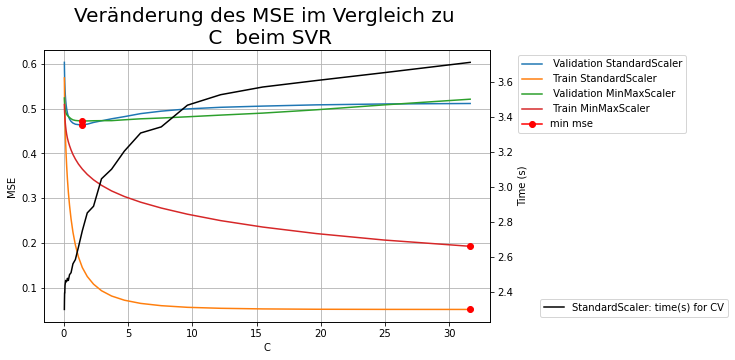

In [42]:
plot_svr2d()

In den unteren beiden Grafiken wird der Mean Squared Error abhängig von den beiden Parameter C und Epsilon noch einmal dreidimensional dargestellt.

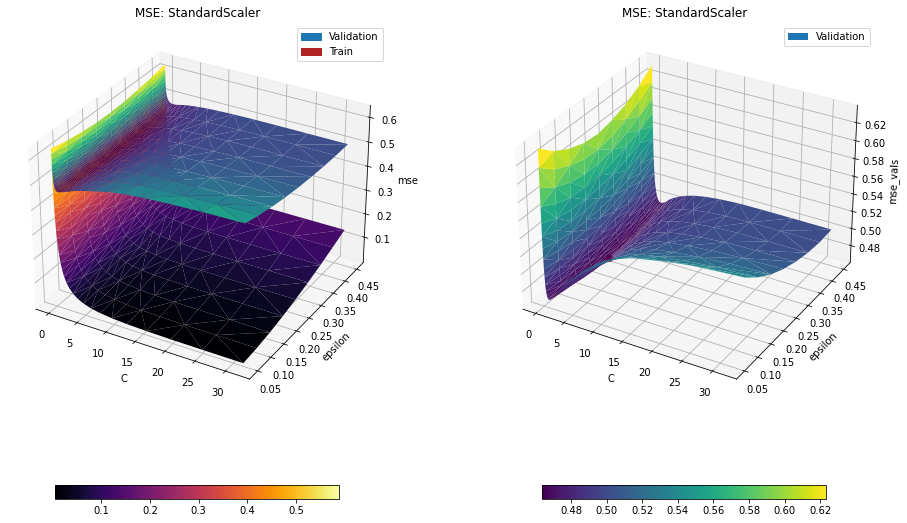

In [43]:
plot_svr_3d() 

### SVR mit Feature Selection

Im Folgenden Kapitel werden die Ergebnisse der Support Vector Regression mit Anwendung der Feature Selection evaluiert um anschließend das beste Modell wählen zu können.

In der Ausgabe der Hyperparameter und deren Validierungs-/Trainingsergebnisse sieht man sehr gut, dass der Durchlauf des Support Vector Regressors mit der Scikit-Learn Funktion MinMaxScaler die besten Ergebnisse erzielt.
Aus diesem Grund werden hier bereits ausschließlich Modelle betrachtet, bei der die Daten mit Hilfe von MinMax skaliert wurden.

Für den Parameter Gamma wird der von Scikit-Learn vorgegebene Wert "scale" verwendet.

In [44]:
df = pd.read_csv('results/train_conf_svr_feat_sel.csv')  
df=df.sort_values(by=['mse_val'])
df.head(5)

,kernel,epsilon,C,gamma,degree,r2score_train,mse_train,acc_train,r2score_val,mse_val,acc_val,scaler,time
0,rbf,0.25,0.699564,scale,0,0.357370,0.485698,0.578348,0.293147,0.533736,0.547690,MinMaxScaler(),2.292870
1,rbf,0.25,0.887720,scale,0,0.364004,0.480685,0.582642,0.292724,0.534056,0.546801,MinMaxScaler(),2.296838
2,rbf,0.25,0.551289,scale,0,0.351147,0.490401,0.574349,0.292262,0.534406,0.546506,MinMaxScaler(),2.263947
3,rbf,0.20,0.699564,scale,0,0.356163,0.486611,0.577163,0.292192,0.534473,0.545915,MinMaxScaler(),2.355726
4,rbf,0.25,1.126482,scale,0,0.370623,0.475683,0.587530,0.291829,0.534728,0.547097,MinMaxScaler(),2.344709


<!-- Das ermittelte C ist kleiner als das Standard C von 1. Da der Parameter invers proportional ist, hat die Regularisierung zugenommen.

Der Wert für epsilon liegt bei 0,25. Das bedeutet, dass viel mehr Werte nicht penalisiert werden, wenn sie falsch klassifiziert wurden.

Da aber der Mean Square Error dieses Models auf den Validierungsdaten größer ist als der MSE des Models ohne Feature Selection. Dies lässt sehr sehr gut aus den Schaubildern herauslesen. Daher fällt dieses Model aus der Auswahl heraus.  -->

In der dreidimensionalen Grafik wird der Mean Suqared Error in Abhängigkeit von den Parametern C und Epsilon grafisch dargestellt.
Bereits hier ist zu erkennen, dass unsere Modelle bei Andwendung von Feature Selection eine schlechtere Vorhersage auf die Validierungsdaten vorweisen.

Die Ursache dafür kann am Informationsverlust liegen, wenn Features durch die Feature Selection nicht in den Lernprozess aufgenommen werden. 

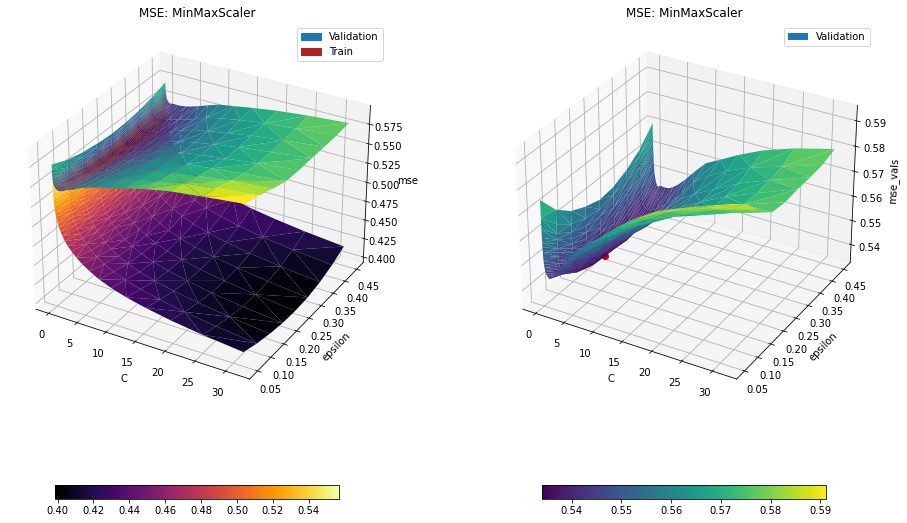

In [45]:
plot_svr_feat_sel3d()

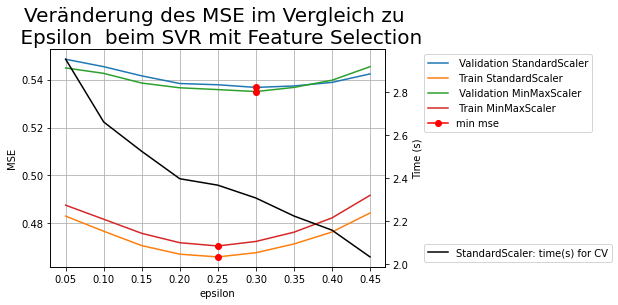

In [46]:
plot_svr2d_feat_sel()

### Auswahl des SVR Modells

Es wird nur ein Modell für die SVR ausgewählt.
Da der Support Vector Regressor bessere Ergebnisse auf den nicht selektierten Datensatz erzielt, wird diese Vorgehensweise gewählt.
Aus diesem Grund wird nur ein Modell auf den Datensatz ohne Feature Selection trainiert .

In [47]:
# Hyperparameter des ausgewählten Modells

df = pd.read_csv('results/train_conf_svr.csv')  
df = df.sort_values(by=['mse_val'])
best_config_svr = df.iloc[0].to_dict()

In [48]:
best_config_svr

{'kernel': 'rbf',
 'epsilon': 0.25,
 'C': 1.4294613383568446,
 'gamma': '0.31622776601683794',
 'degree': 0,
 'r2score_train': 0.8080529387016915,
 'mse_train': 0.1450693197797238,
 'acc_train': 0.8982526284614245,
 'r2score_val': 0.3859280363707231,
 'mse_val': 0.4635654466182942,
 'acc_val': 0.605451220314453,
 'scaler': 'StandardScaler()',
 'time': 2.7506747245788574}

# Training der endgültigen Modelle mit den oben bestimmten Hyperparametern

Hier werden die oben ausgewählten Modelle erneut auf den Trainingsdatensatz trainiert, um sie anschließend auf dem Testdatensatz, welcher zu Begin zur Seite gelegt wurde, bewerten zu können.

In [49]:
train_df, test_df = get_datasets(logarithm=True, feature_selection=False)

X_train = train_df.drop("quality",axis=1).values
X_test = test_df.drop("quality",axis=1).values

y_train = train_df["quality"].values
y_test = test_df["quality"].values


rfr_model = RandomForestRegressor_train(X_train, y_train, hyperparameter = best_config_tree, cross_validation = False)
svr_model = SupportVectorRegressor_train(X_train, y_train, cross_validation=False, hyperparameter=best_config_svr, kernel = "rbf")


# Ergebnisse

## Random Forest Regression

In der folgenden Grafik werden die Regressionsmetriken der Genauigkeit und Mean Squared Error dargestellt.
Da unsere Zielvariable aus diskreten Werten besteht und unsere Regressionsvorhersagen stetig sind, muss zur Berechnung der Genauigkeit der Vorhersagewert gerundet werden.

Der Random Forest Regressor erzielt gute Ergebnisse auf allen Datensätze. Die deutlich besseren Ergebnisse auf den Trainingsdatensatz lassen auf eine hohe Varianz deuten. 

Das Modell erzielt nahezu die gleichen Ergebnisse auf Test- und Validierungsdatensatz.

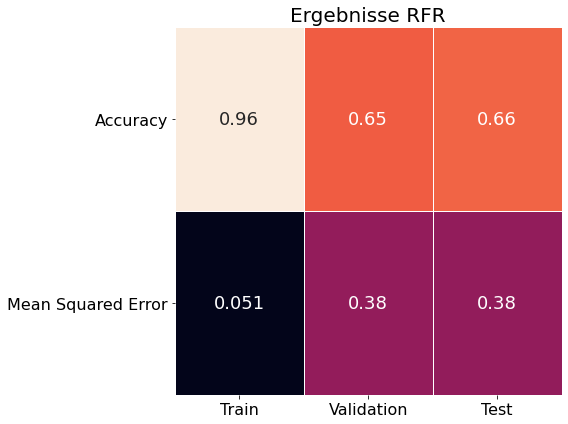

In [50]:
y_pred_rfr = rfr_model.predict(X_test)

plot_metrics(y_test, y_pred_rfr, best_config_tree, modelname = "RFR")

Die folgende Tabelle zeigt die Wichtigkeit der Features auf die Vorhersage.
Wie bereits erwartet, hat der Alkoholgehalt bzw der logarithmierte Alkoholgehalt den größten Einfluss auf die Vorhersage des Modells.

Im Kapitel Datenanalyse wurde bereits festgestellt dass das Feature Alkoholgehalt eine mäßig-starke Korrelation zur Zielvariablen Qualität aufweist.

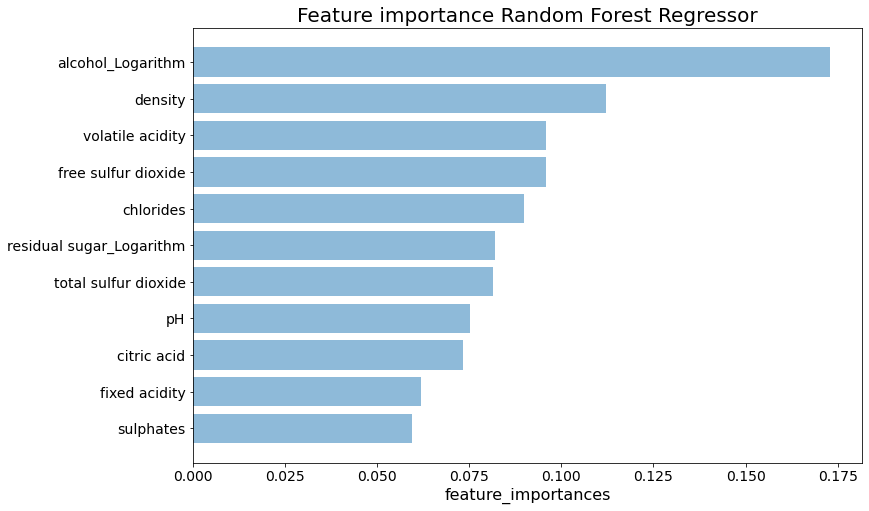

In [51]:
plot_rfrfeatureimportance(rfr_model, train_df)

Hier wird die Vorhersage des Modells noch einmal den wahren Werten gegenübergestellt, dabei werden sowohl die gerundeten Vorhersagen als auch die stetige Vorhersage dargestellt.

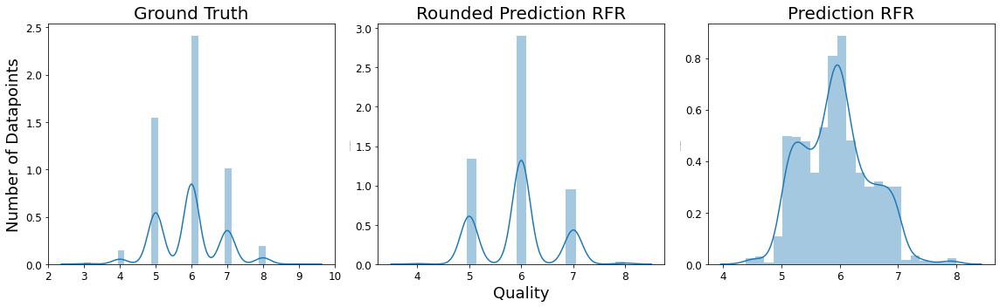

In [52]:
plot_histograms(y_test, y_pred_rfr, modelname = "RFR")


Die Confusion Matrix gibt uns etwas mehr Aufschluss über die Qualität unseres Modells.
Hier werden zusätzlich für alle Klassen der Recall und Precision berechnet.

Recall: $\frac{TP}{TP+FN}$ <br>
Precision $\frac{TP}{TP+FP}$


Man kann der Tabelle entnehmen, dass für die Qualitäten 8 und 4 eine sehr hohe Precision berechnet wurde, was daran liegt dass wenige Datenpunkte dieser Klasse sehr gut vorhergesagt werden konnten.
Der hier interessantere Recall Wert gibt uns jedoch Aufschluss darüber, dass viele Weine der Qualität 4 und 8 nicht richtig klassifiziert wurden.

Ein besseres Ergebnis sieht man bei den Weinen der Qualität 5,6 und 7.
Dies ist wenig überraschend, da für diese Klassen die meisten Daten zur Verfügung standen.

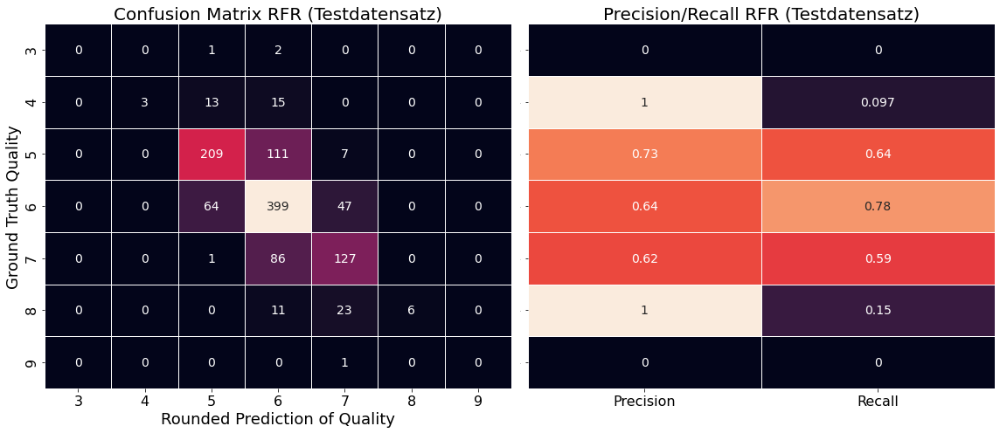

In [53]:
plot_confusion_matrix(y_test, y_pred_rfr, modelname = "RFR", datensatz = "(Testdatensatz)")

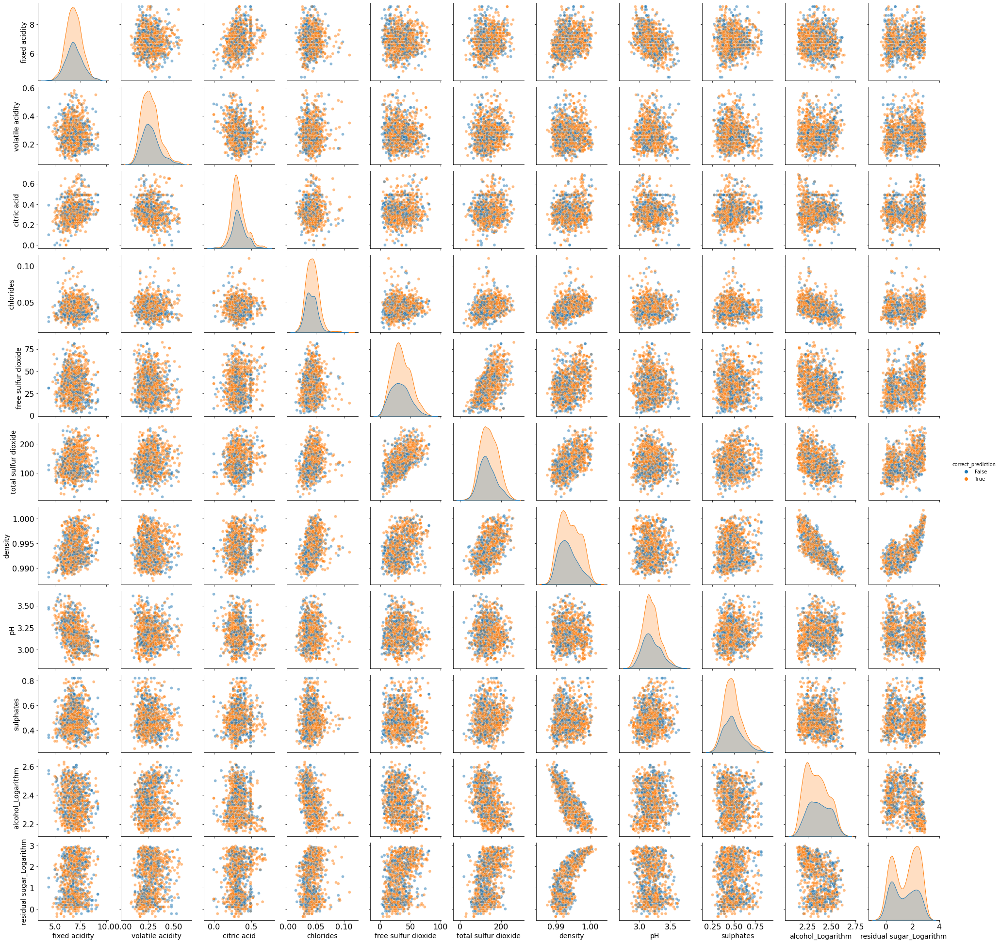

In [54]:
plot_correct_prediction_pairplot(y_test, y_pred_rfr, test_df)

## SVR ohne Featureselection

In der folgenden Grafik werden die Regressionsmetriken der Genauigkeit und Mean Squared Error dargestellt.

Wie zuvor der Random Forest Regressor erzielt auch der Support Vector Regressor sehr gute Ergebnisse.
Das Modell performt auf die Testdaten ähnlich gut wie auf den Validierungsdaten. 
Es ist allerdings wieder klar zu erkennen, dass die Genauigkeit, als auch der Mean Squared Error auf den Trainingsdaten deutlich besser ist.

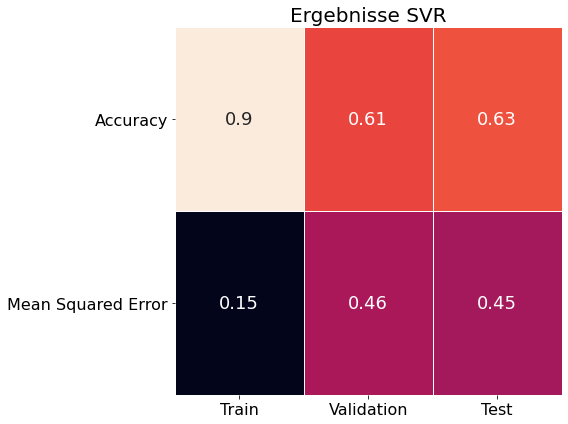

In [55]:
y_pred_svr = svr_model.predict(X_test)

plot_metrics(y_test, y_pred_svr, best_config_svr, modelname="SVR")


Hier wird die Vorhersage des Models noch einmal den wahren Werten gegenübergestellt, dabei werden sowohl die gerundeten Vorhersagen als auch die stetige Vorhersage dargestellt.

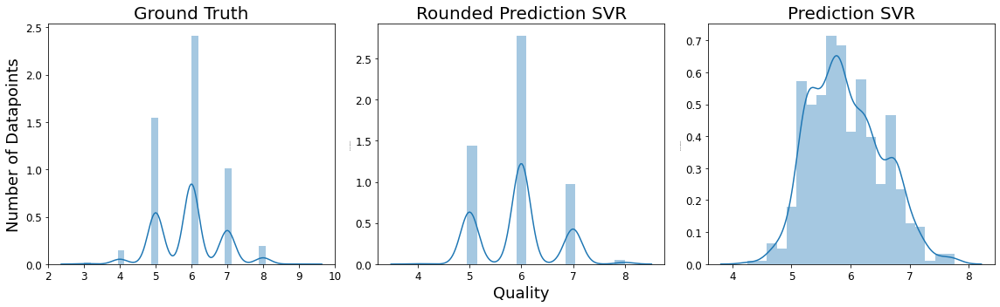

In [56]:
plot_histograms(y_test, y_pred_svr, modelname="SVR")


Wie schon die Confusion Matrix bei dem Random Forest Regressor zeigt sich der unausgeglichene Datensatz ebenfalls in den Ergebnissen der Confusion Matrix des Support Vector Regressors. 

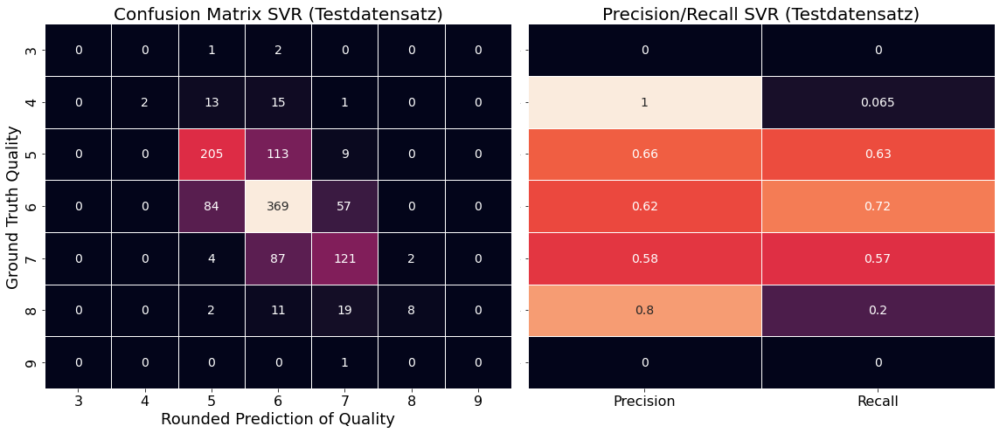

In [57]:
plot_confusion_matrix(y_test, y_pred_svr, modelname="SVR", datensatz="(Testdatensatz)")

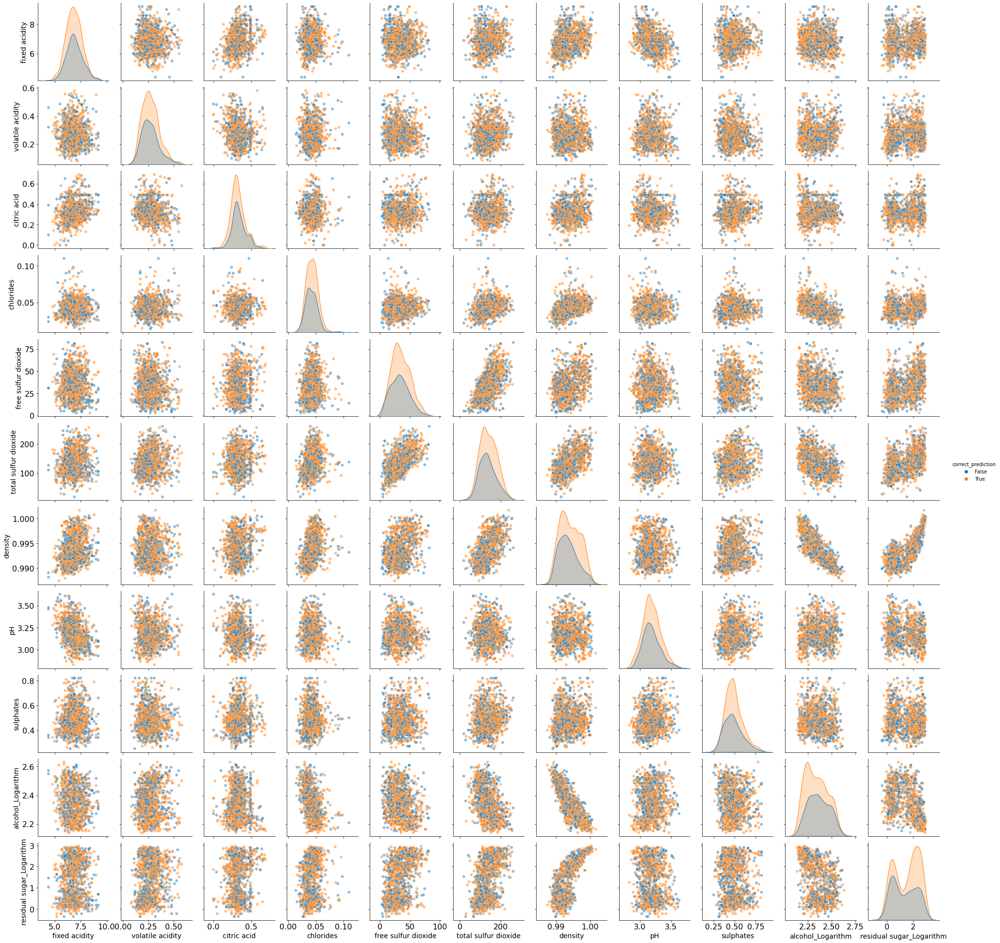

In [58]:
plot_correct_prediction_pairplot(y_test, y_pred_svr, test_df)

# Additional Work

## Ensemble Modell
Zusätzlich zu den oben beschriebenen Modellen, wurde ein Voting Ensemble der beiden Algorithmen erstellt.

Aus den anschließenden Plots ist zu erkennen, dass das erstellte Ensemble Modell nicht wesentlich verbessert. Dies könnte daran liegen, dass der Random Forest Regressor bereits intern ein Ensemblemodell aus vielen verschiedenen Entscheidungsbäumen ist und bereits bessere Ergebnisse als der Support Vector Regressor erzielt.

In [59]:
y_pred = np.mean(np.asarray([svr_model.predict(X_test), rfr_model.predict(X_test)]),axis = 0)

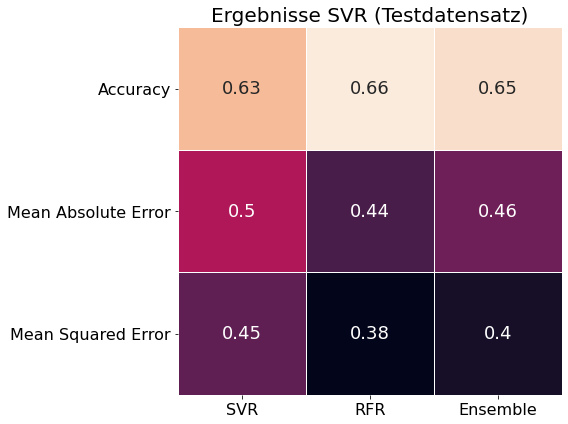

In [60]:
plot_metrics_ensemble(y_test, y_pred, predictions=[y_pred_svr, y_pred_rfr], modelname="SVR")

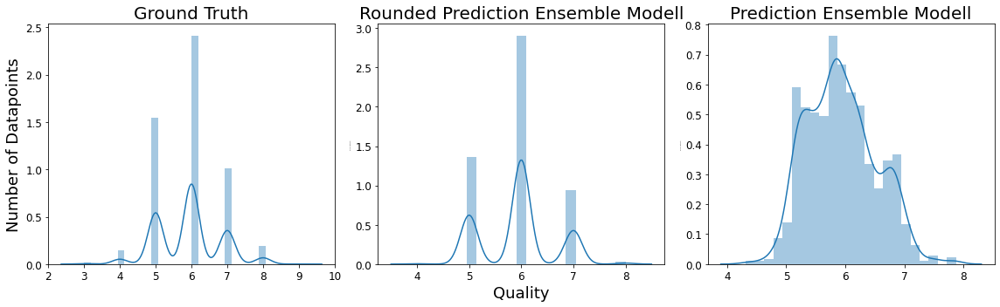

In [61]:
plot_histograms(y_test, y_pred, modelname="Ensemble Modell")

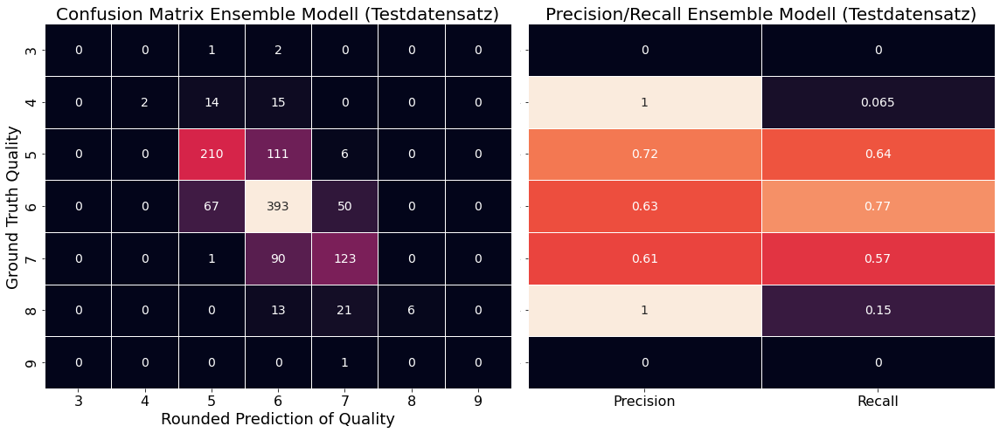

In [62]:
plot_confusion_matrix(y_test, y_pred, modelname="Ensemble Modell", datensatz="(Testdatensatz)")

# Fazit

Die Ergebnisse beider Modelle sind vorzeigbar. Beide Modelle haben einen guten Mean Squared Error auf den Testdatensatz. 
Das Random Forest Regressor Modell hat dabei bessere Ergebnisse als der Support Vector Regressor erzielt.
Die Feature Selection hat bei diesem Datensatz zu starkem Informationsverlust und somit zu deutlich schlechtere Ergnissen geführt.

Die schlechteren Ergebnisse bei den weniger vertretenen Klassen waren zu erwarten und akzeptabel, da diese auf Sicht des gesamten Datensatzes nur in sehr kleiner Anzahl vorkommen. Eine Gewichtung oder Oversampling dieser Gruppen zur Verschlechterung der Precision der häufigeren vorkommenen Klassen führen. Dies kann dazu führen, dass Modelle auf zukünftige Daten die Vorhersage der weniger vorkommenen Klassen präferenzieren und somit die Klassenverteilung der Vorhersage und die der realen Werte abweichen.

Grundsätzlich muss man mit diesem Datensatz kritisch umgehen da die subjektive Einordnung durch Weinexperten keine wissenschaftlich basierte Einordnung ist und schlechtere Ergebnisse von Modellen auch auf eine Inkonsistenz dieser Einordnung zurückzuführen werden könnte.



